In [1]:
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
import time
import sys

from sklearn.cluster import MiniBatchKMeans
import seaborn as sns


def get_windows(job,n_neighbors):
    start_time,idx,tissue_name,indices = job
    job_start = time.time()
    
    print ("Starting:", str(idx+1)+'/'+str(len(exps)),': ' + exps[idx])

    tissue = tissue_group.get_group(tissue_name)
    to_fit = tissue.loc[indices][[X,Y]].values

    fit = NearestNeighbors(n_neighbors=n_neighbors).fit(tissue[[X,Y]].values)
    m = fit.kneighbors(to_fit)

    #sort_neighbors
    args = m[0].argsort(axis = 1)
    add = np.arange(m[1].shape[0])*m[1].shape[1]
    sorted_indices = m[1].flatten()[args+add[:,None]]

    neighbors = tissue.index.values[sorted_indices]
   
    end_time = time.time()
   
    print ("Finishing:", str(idx+1)+"/"+str(len(exps)),": "+ exps[idx],end_time-job_start,end_time-start_time)
    return neighbors.astype(np.int32)

In [2]:
df = pd.read_csv('Cell_Atlas_final_cell_types_04_21.csv', index_col=0,header=0, low_memory=False)

In [3]:
print(df.shape)
df.head(5)

(911944, 64)


,CHGA,MMP9,CD36,CK7,PDL1,Bcatenin,Vimentin,FoxP3,CD56,CD31,...,region_num,CD206,CollIV,Christian_annotations,unique_region,final_cell_types,Accession_number,Block_ID,Sample_type,Path_report
0,-0.172401,4.352966,-0.639224,-0.086951,0.249551,-0.775730,-0.378593,-0.148040,-0.135123,-0.203065,...,reg001,21231.513817,845.184447,neutrophils,E08_reg001,Neutrophil,AS19-51072,B1,Biopsy,Tumor + Dysplasia
1,-0.041456,0.101160,0.304395,-0.076222,1.351610,-0.775730,-0.378593,-0.022287,-0.236557,-0.158086,...,reg001,22163.942563,288.604886,stroma & smooth muscle (if you think it is imp...,E08_reg001,Stroma,AS19-51072,B1,Biopsy,Tumor + Dysplasia
2,0.201529,-0.006967,0.927195,-0.086013,-0.071495,0.148315,-0.378593,-0.148040,0.179793,-0.203065,...,reg001,13595.723256,55.403949,stroma & smooth muscle (if you think it is imp...,E08_reg001,Stroma,AS19-51072,B1,Biopsy,Tumor + Dysplasia
3,-0.252746,-0.183261,-0.144306,-0.086951,-0.395185,0.029715,-0.361982,-0.148040,-0.325093,-0.203065,...,reg001,21099.704006,10.762187,glandular epithelium; except in E18d and E19d ...,E08_reg001,Epi_MUC5AC,AS19-51072,B1,Biopsy,Tumor + Dysplasia
4,-0.011287,-0.193658,-0.088877,-0.086951,0.039025,0.197819,-0.375742,-0.110929,0.798408,-0.202419,...,reg001,22793.003799,757.790430,stroma & smooth muscle (if you think it is imp...,E08_reg001,Smooth_Muscle,AS19-51072,B1,Biopsy,Tumor + Dysplasia


In [4]:
df['sample'].value_counts()

E19    300539
E18    266283
E12    147583
E08     73775
E11     65782
E17     57982
Name: sample, dtype: int64

In [5]:
pd.crosstab(df['sample'].astype('category'), df['final_cell_types'].astype('category'))

final_cell_types,B,CD4T,CD4T_PD1hi,CD4Treg,CD8T,CD8T_PD1hi,DC,Endothelial,Endothelial_CD36hi,Endothelial_aSMAhi,...,Lymphatic,Lymphatic_CD73hi,M1_Macrophage,M2_Macrophage,Nerve,Neutrophil,Plasma,Smooth_Muscle,Stroma,Stroma_CD73
sample,,,,,,,,,,,,,,,,,,,,,
E08,68,683,912,1049,738,704,380,3568,910,3,...,1302,0,1815,755,383,6817,2081,1701,3836,3
E11,3472,2173,955,1092,783,194,238,5449,913,24,...,1201,0,3312,369,295,441,3441,3047,13290,1
E12,353,3679,2474,1443,7742,2216,64,4660,3411,0,...,3462,431,2120,7144,3704,3211,3978,9657,16369,824
E17,542,1483,532,674,1647,502,170,3115,799,26,...,1116,0,4030,1960,886,3970,397,4095,3700,0
E18,4206,5967,1743,2436,7547,1254,2713,12602,6752,16,...,2489,0,18755,4327,3259,34299,2725,20181,28676,7
E19,8105,7011,2344,6042,13406,4119,1305,15272,3903,861,...,2797,0,13880,8676,746,6732,5567,37662,31983,12


In [6]:
df.columns

Index(['CHGA', 'MMP9', 'CD36', 'CK7', 'PDL1', 'Bcatenin', 'Vimentin', 'FoxP3',
       'CD56', 'CD31', 'pH2AX', 'CD90', 'CD15', 'PD1', 'aSMA', 'CD25', 'Ki67',
       'Cytokeratin', 'CD20', 'CD4', 'CD11c', 'AnnexA1', 'Nestin', 'p53',
       'CD73', 'EGFR', 'MUC5AC', 'HLADR', 'COX2', 'BCL2', 'p63', 'CD3', 'MUC2',
       'CD8', 'CD45', 'PGA3', 'CD57', 'CD68', 'aDef5', 'CD34', 'Podoplanin',
       'CD38', 'CD11b', 'CD163', 'MUC1', 'CD138', 'Arginase1', 'PP', 'CD79a',
       'MUC6', 'region', 'x', 'y', 'sample', 'region_num', 'CD206', 'CollIV',
       'Christian_annotations', 'unique_region', 'final_cell_types',
       'Accession_number', 'Block_ID', 'Sample_type', 'Path_report'],
      dtype='object')

In [7]:
print(df.shape)
#remove E18
df['sample'].value_counts()
df = df[df["sample"]!="E18"]
print(df.shape)

(911944, 64)
(645661, 64)


In [8]:
df['Path_report'].value_counts()

Normal esophagus                  320998
Metaplasia + Dysplasia + Tumor    147583
Tumor + Metaplasia                 56119
Metaplasia                         43407
Tumor                              22210
Metaplasia; Dysplasia?             19318
Normal esophagus; Tumor?           16047
Metaplasia + Tumor                 10159
Tumor + Dysplasia                   9820
Name: Path_report, dtype: int64

In [9]:
df['Sample_type'].value_counts()

Resection    448122
Biopsy       197539
Name: Sample_type, dtype: int64

In [10]:
#Add Christian's annotation
path_tab = pd.read_csv("CODEX_Blocks_12Aug20_shipping_list.csv")
path_tab.head()

,Accession number,Block ID,Sample type,Report description,CRUK ID,Used,Christian's name,Amounts
0,AS19-51072,A1,Biopsy,Metaplasia,E08,x,Metaplasia,NaN
1,AS19-51072,B1,Biopsy,Tumor + Dysplasia,NaN,x,HGD & Metaplasia,NaN
2,AS19-51072,C1,Biopsy,Tumor + Metaplasia,NaN,x,HGD & Metaplasia,NaN
3,AS19-51072,D1,Biopsy,Normal esophagus,NaN,x,Squamous,NaN
4,AS19-60110,A1,Biopsy,Normal stomach,E11,NaN,NaN,NaN


In [11]:
#remove NAs from Christian's name column
print(path_tab.shape)
path_tab.dropna(subset=["Christian's name"], inplace=True)
print(path_tab.shape)
path_tab.head()

(25, 8)
(14, 8)


,Accession number,Block ID,Sample type,Report description,CRUK ID,Used,Christian's name,Amounts
0,AS19-51072,A1,Biopsy,Metaplasia,E08,x,Metaplasia,NaN
1,AS19-51072,B1,Biopsy,Tumor + Dysplasia,NaN,x,HGD & Metaplasia,NaN
2,AS19-51072,C1,Biopsy,Tumor + Metaplasia,NaN,x,HGD & Metaplasia,NaN
3,AS19-51072,D1,Biopsy,Normal esophagus,NaN,x,Squamous,NaN
5,AS19-60110,B1,Biopsy,Metaplasia + Tumor,NaN,x,Metaplasia,NaN


In [12]:
#create dictionary for the refined path
path_tab.index = path_tab['Accession number'] + "_" + path_tab['Block ID']
path_tab_dict = path_tab['Christian\'s name'].to_dict()

In [13]:
#convert
df['refined_pathRep'] = (
    (df["Accession_number"]+"_"+df["Block_ID"])
    .map(path_tab_dict).astype("category")
)

In [14]:
df['refined_pathRep'].value_counts()

HGD & Metaplasia & Glandular epithelium & Squamous    448122
HGD & Metaplasia                                       64637
Metaplasia                                             44088
Tumor & Glandular epithelium                           30098
Tumor                                                  22210
Squamous                                               20459
Squamous & Adenocarcinoma                              16047
Name: refined_pathRep, dtype: int64

In [15]:
#convert cell types to integrated ones
convTab = pd.read_csv("StCa_ESO-ATLAS-CODEX-integrationCelltype_JH_ISB_v3.csv")
convTab.head()

,Unnamed: 0,CODEX,CODEX.1,CODEX.2,McD lab,Goldenring lab,Subtype,CODEX.3,CODEX,Integrated name,...,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32
0,NaN,Name_in_Codex (reordered,"markers used (..., ..., ...)",Proposed Name,NaN,NaN,NaN,Cell Ontology,Cell Ontology Link,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,Epi,"Cytokeratin, Bcatenin,",Epithelial cell,NaN,NaN,Epithelial,Simple columnar epithelial cell,http://purl.obolibrary.org/obo/NCIT_C33552,Epithelial cell,...,22,24.0,25.0,28.0,30.0,32.0,32.0,35.0,37.0,42.0
2,2.0,Epi_aDef5,"Cytokeratin, Bcatenin, aDefensin",Paneth cell,NaN,NaN,Epithelial,Paneth cell,http://purl.obolibrary.org/obo/NCIT_C12593,Paneth cell,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3.0,Epi_AnnexinA1,"Cytokeratin, Bcatenin, Annexin A1",Squamous Epithelial cell,"A1 hi = differentiated , A1med/lo = basal",NaN,Epithelial,Esophageal Squamous Epithelium,http://purl.obolibrary.org/obo/NCIT_C49222,Squamous,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4.0,Epi_CD73,"Cytokeratin, Bcatenin, CD73",CD73+ Epithelial cell,NaN,NaN,Epithelial,Simple columnar epithelial cell,http://purl.obolibrary.org/obo/NCIT_C33552,Epithelial cell,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
tab = pd.DataFrame(convTab[["CODEX","Integrated name"]])
tab = tab.iloc[1:,:]
tab.index = tab["CODEX"]
tab = tab.iloc[:,1:]
print(tab.head())
tab = tab.to_dict()
tab = tab['Integrated name']
print(tab)

               Integrated name
CODEX                         
Epi            Epithelial cell
Epi_aDef5          Paneth cell
Epi_AnnexinA1         Squamous
Epi_CD73       Epithelial cell
Epi_CHGA        Neuroendocrine
{'Epi': 'Epithelial cell', 'Epi_aDef5': 'Paneth cell', 'Epi_AnnexinA1': 'Squamous', 'Epi_CD73': 'Epithelial cell', 'Epi_CHGA': 'Neuroendocrine', 'Epi_CK7': 'Epi_metaplasia', 'Epi_CK7_p53': 'Epi_metaplasia', 'Epi_HLADR': 'Epithelial cell', 'Epi_Ki67_p53': 'Epi_dysplasia', 'Epi_MUC1_Ki67': 'Epithelial cell', 'Epi_MUC2': 'Goblet cell', 'Epi_MUC2_p53': 'Goblet cell', 'Epi_MUC2_p53_Ki67': 'Goblet cell', 'Epi_MUC5_p53': 'Foveolar cell', 'Epi_MUC5_p53_Ki67': 'Foveolar cell', 'Epi_MUC5AC': 'Foveolar cell', 'Epi_MUC5AC_Ki67_p53': 'Foveolar cell', 'Epi_MUC6': 'Gastric mucous secreting cell', 'Epi_MUC6_p53': 'Gastric mucous secreting cell', 'Epi_MUC6_p53_Ki67': 'Gastric mucous secreting cell', 'Epi_p53': 'Epi_dysplasia', 'Epi_p63_EGFR': 'Esophageal Squamous Epithelium', 'Epi_p63_EGFR

In [17]:
df['iCellType'] = (
    df['final_cell_types']
    .map(tab).astype("category")
)

In [18]:
df['iCellType'].value_counts()

Foveolar cell                          71976
Stromal cell                           70018
smooth muscle cells, myofibroblasts    56162
Epi_metaplasia                         50137
Macrophage                             44061
Esophageal Squamous Epithelium         38131
Epithelial cell                        36428
CD8+ T cell                            32051
Gastric mucous secreting cell          27102
Squamous                               26751
CD4+ T cell                            25329
Neutrophil                             21171
Plasma cell                            15464
Epi_dysplasia                          13655
B cell                                 12540
Goblet cell                            12469
Endothelial cell                       10850
Lymphatic                              10309
Chief cell                              9348
Parietal cell                           8314
Neuron                                  6014
Neuroendocrine                          5524
Dendritic 

In [19]:
tab2 = pd.DataFrame(convTab[["CODEX","CODEX.2"]])
tab2 = tab2.iloc[1:,:]
tab2.index = tab2["CODEX"]
tab2 = tab2.iloc[:,1:]
print(tab2.head())
tab2 = tab2.to_dict()
tab2 = tab2['CODEX.2']
print(tab2)

                                CODEX.2
CODEX                                  
Epi                     Epithelial cell
Epi_aDef5                   Paneth cell
Epi_AnnexinA1  Squamous Epithelial cell
Epi_CD73          CD73+ Epithelial cell
Epi_CHGA            Neuroendocrine cell
{'Epi': 'Epithelial cell', 'Epi_aDef5': 'Paneth cell', 'Epi_AnnexinA1': 'Squamous Epithelial cell', 'Epi_CD73': 'CD73+ Epithelial cell', 'Epi_CHGA': 'Neuroendocrine cell', 'Epi_CK7': 'CK7+ Epithelial cell', 'Epi_CK7_p53': 'CK7+, p53+ Epithelial cell', 'Epi_HLADR': 'HLADR+ Epithelial cell', 'Epi_Ki67_p53': 'Ki67+, p53+ Epithelial cell', 'Epi_MUC1_Ki67': 'MUC1+, Ki67+ Epithelial cell', 'Epi_MUC2': 'Goblet cell', 'Epi_MUC2_p53': 'p53+ Goblet cell', 'Epi_MUC2_p53_Ki67': 'p53+, Ki67+ Goblet cell', 'Epi_MUC5_p53': 'p53+ Foveolar cell', 'Epi_MUC5_p53_Ki67': 'p53+, Ki67+ Foveolar cell', 'Epi_MUC5AC': 'Foveolar cell', 'Epi_MUC5AC_Ki67_p53': 'p53+, Ki67+ Foveolar cell', 'Epi_MUC6': 'Gastric mucous secreting cell', 'Epi_M

In [20]:
df['CODEX2'] = (
    df['final_cell_types']
    .map(tab2).astype("category")
)

In [21]:
df['CODEX2'].value_counts()

Stromal cell                              69178
Foveolar cell                             65508
Muscle cell                               56162
CK7+, p53+ Epithelial cell                48958
Squamous Epithelial cell                  26751
Gastric mucous secreting cell             25607
M1 Macrophage                             25157
p63+ Squamous Epithelial cell             24430
CD8+ T cell                               24316
Neutrophil                                21171
Epithelial cell                           20968
M2 Macrophage                             18904
Plasma cell                               15464
CD4+ T cell                               15029
EGFRhi+, p63+ Squamous Epithelial cell    13701
B cell                                    12540
CD4+ T regulatory cell                    10300
CD36+ Endothelial cell                     9936
Lymphatic Endothelial cell                 9878
Chief cell                                 9348
Goblet cell                             

In [22]:
df.to_csv('Cell_Atlas_final_cell_types_11_11.csv')

### Fill In:
    -ks = individual window sizes to collect
    -path_to_data:  file path for csv file with x,y cluster information
    -X:  column to use for X location
    -Y:  column to use for Y location
    -reg:  column to use for region (should be different for every tissue)
    -file_type('csv','pickle'):  file type
    -cluster_col : column name of cell type cluster to be used for neighborhoods
    -cellhierpath:  path to cellhier libary (should only have to set once per computer
    -keep_cols:  columns to transfer from original dataframe to dataframe with windows and neighborhoods

# I. Analyze with codex2 celltype name

### Cell type composition

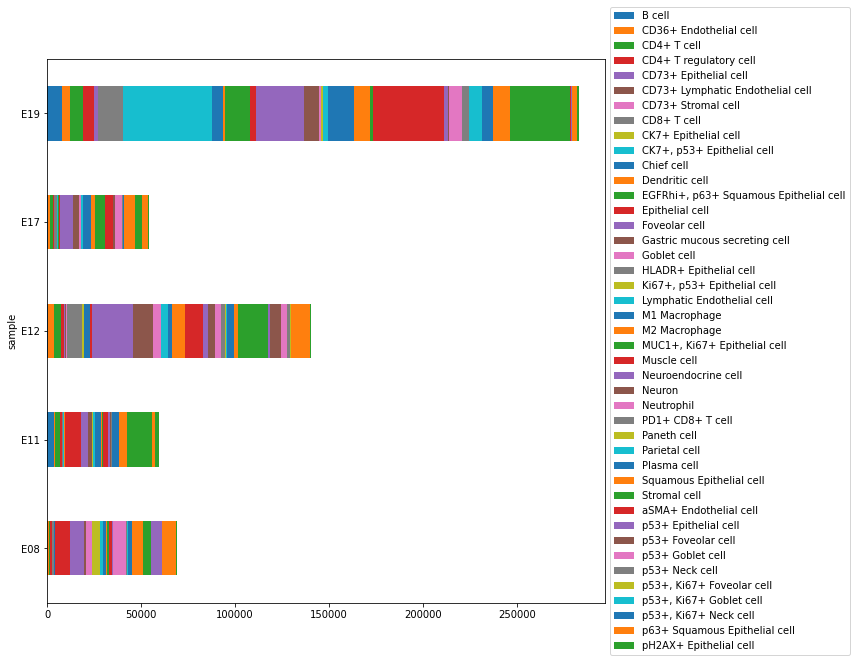

In [23]:
#plotting option1
#pd.crosstab(df['sample'], df['final_cell_types']).plot(kind='barh', stacked=True,figsize = (10,12))
#plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
#plt.show()
import matplotlib.pyplot as plt

#plotting option2
ax = pd.crosstab(df['sample'], df['CODEX2']).plot(kind='barh', stacked=True,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_hstack.png', bbox_inches='tight')

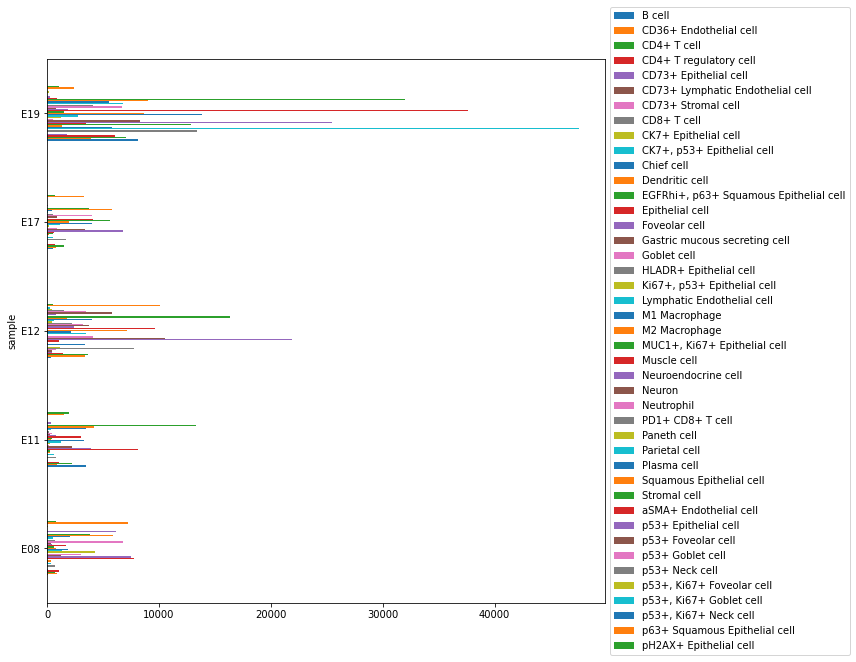

In [24]:
#plotting option1
#pd.crosstab(df['sample'], df['final_cell_types']).plot(kind='barh', figsize = (10,10))
#plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
#plt.show()

#plotting option2
ax = pd.crosstab(df['sample'], df['CODEX2']).plot(kind='barh', stacked=False,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_hUNstack.png', bbox_inches='tight')

### Cell Type Percentage

In [28]:
st = pd.crosstab(df['sample'], df['CODEX2'])
df_perc=(st/np.sum(st, axis = 1)[:,None])* 100
df_perc
#df_perc['sample'] = df_perc.index
#df_perc

<ipython-input-28-0bbb7e0251fb>:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  df_perc=(st/np.sum(st, axis = 1)[:,None])* 100


CODEX2,B cell,CD36+ Endothelial cell,CD4+ T cell,CD4+ T regulatory cell,CD73+ Epithelial cell,CD73+ Lymphatic Endothelial cell,CD73+ Stromal cell,CD8+ T cell,CK7+ Epithelial cell,"CK7+, p53+ Epithelial cell",...,aSMA+ Endothelial cell,p53+ Epithelial cell,p53+ Foveolar cell,p53+ Goblet cell,p53+ Neck cell,"p53+, Ki67+ Foveolar cell","p53+, Ki67+ Goblet cell","p53+, Ki67+ Neck cell",p63+ Squamous Epithelial cell,pH2AX+ Epithelial cell
sample,,,,,,,,,,,,,,,,,,,,,
E08,0.098131,1.313226,0.985641,1.513818,0.103904,0.000000,0.004329,1.065012,0.000000,0.515189,...,0.004329,8.908291,0.000000,0.00,0.000000,0.089473,0.000000,0.000000,10.365827,1.141497
E11,5.847284,1.537607,3.659605,1.839065,0.176833,0.000000,0.001684,1.318670,0.000000,0.951531,...,0.040419,0.584392,0.000000,0.00,0.000000,0.043787,0.000000,0.000000,2.484085,3.290781
E12,0.251337,2.428640,2.619456,1.027419,0.309009,0.306873,0.586690,5.512321,0.839451,0.000000,...,0.000000,0.551802,4.096861,2.45,1.045931,0.297617,0.171593,0.018512,7.164166,0.342473
E17,0.997515,1.470507,2.729364,1.240453,0.014723,0.000000,0.000000,3.031195,0.000000,0.962547,...,0.047851,0.136192,0.000000,0.00,0.000000,0.023926,0.000000,0.000000,6.038465,1.205484
E19,2.864737,1.379527,2.478059,2.135563,0.612888,0.000000,0.004241,4.738392,0.000000,16.793615,...,0.304323,0.098260,0.000000,0.00,0.000000,0.068923,0.000000,0.000000,0.858537,0.362643


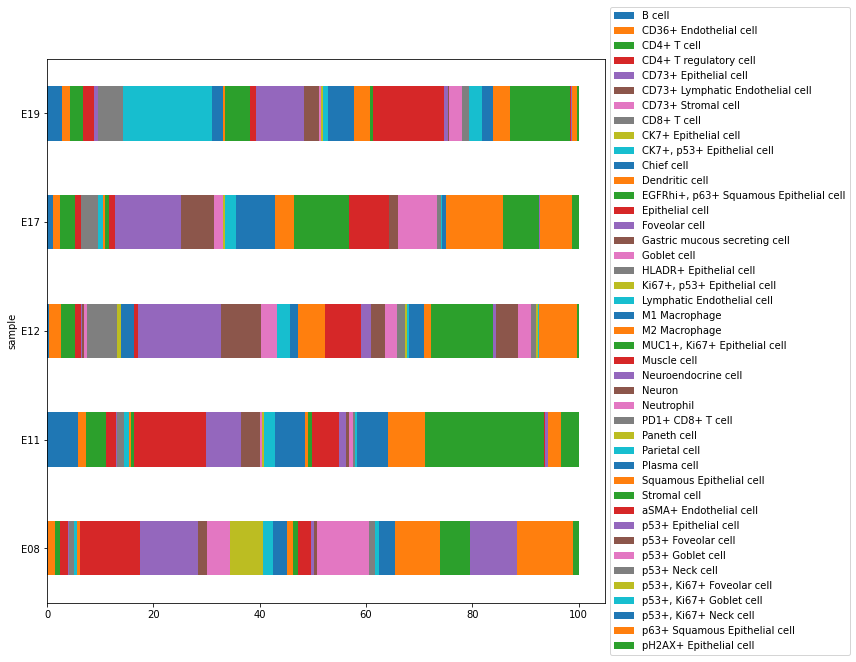

In [30]:
tmp=st.T.apply(
    lambda x: 100 * x / x.sum()
)

ax = tmp.T.plot(kind='barh', stacked=True,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_perc_hstack.png', bbox_inches='tight')

### Neighborhood analysis

In [31]:
df["unique_region"].value_counts()

E19_reg003    86365
E19_reg004    77420
E19_reg001    75774
E19_reg002    60980
E12_reg003    40266
E12_reg002    32934
E12_reg001    31906
E17_reg005    22210
E12_reg004    21458
E12_reg005    21019
E11_reg002    18430
E08_reg006    15214
E08_reg004    14338
E08_reg005    11683
E11_reg001    11668
E11_reg003    10159
E11_reg006    10090
E08_reg001     9820
E11_reg004     9478
E08_reg007     9395
E17_reg006     9320
E17_reg002     8947
E08_reg003     7376
E17_reg001     7134
E11_reg005     5957
E08_reg002     5949
E17_reg004     5214
E17_reg003     5157
Name: unique_region, dtype: int64

In [34]:
#Choose this information and input based on above
ks = [20, 30, 35] # k=5 means it collects 5 nearest neighbors for each center cell
path_to_data = 'Cell_Atlas_final_cell_types_11_11.csv'
X = 'x'
Y = 'y'
reg = 'unique_region'
file_type = 'csv'

cluster_col = 'final_cell_types'
cellhier_path = 'cellhier/'
keep_cols = [X,Y,reg,cluster_col]
save_path = 'analysis/codex2/'

In [35]:
#Import Data
n_neighbors = max(ks)
sys.path.append(cellhier_path)
from cellhier.general import *

cells = pd.read_csv(path_to_data)

cells = pd.concat([cells,pd.get_dummies(cells[cluster_col])],1)
sum_cols = cells[cluster_col].unique()
values = cells[sum_cols].values

/usr/local/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3169: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [36]:
cells[reg] = cells[reg].astype('str')

In [37]:
#Get each region
tissue_group = cells[[X,Y,reg]].groupby(reg)
exps = list(cells[reg].unique())
tissue_chunks = [(time.time(),exps.index(t),t,a) for t,indices in tissue_group.groups.items() for a in np.array_split(indices,1)] 
tissues = [get_windows(job,n_neighbors) for job in tissue_chunks]

Starting: 1/28 : E08_reg001
Finishing: 1/28 : E08_reg001 0.08709192276000977 0.0899510383605957
Starting: 2/28 : E08_reg002
Finishing: 2/28 : E08_reg002 0.03626418113708496 0.1393880844116211
Starting: 3/28 : E08_reg003
Finishing: 3/28 : E08_reg003 0.04579782485961914 0.18673491477966309
Starting: 4/28 : E08_reg004
Finishing: 4/28 : E08_reg004 0.10050415992736816 0.28825902938842773
Starting: 5/28 : E08_reg005
Finishing: 5/28 : E08_reg005 0.07040786743164062 0.361314058303833
Starting: 6/28 : E08_reg006
Finishing: 6/28 : E08_reg006 0.1129462718963623 0.4762082099914551
Starting: 7/28 : E08_reg007
Finishing: 7/28 : E08_reg007 0.061537981033325195 0.5404610633850098
Starting: 8/28 : E11_reg001
Finishing: 8/28 : E11_reg001 0.07329678535461426 0.6158089637756348
Starting: 9/28 : E11_reg002
Finishing: 9/28 : E11_reg002 0.12353515625 0.741081714630127
Starting: 10/28 : E11_reg003
Finishing: 10/28 : E11_reg003 0.06132626533508301 0.8062610626220703
Starting: 11/28 : E11_reg004
Finishing: 11/2

In [38]:
#Loop over k to compute neighborhoods
out_dict = {}
for k in ks:
    for neighbors,job in zip(tissues,tissue_chunks):

        chunk = np.arange(len(neighbors))#indices
        tissue_name = job[2]
        indices = job[3]
        window = values[neighbors[chunk,:k].flatten()].reshape(len(chunk),k,len(sum_cols)).sum(axis = 1)
        out_dict[(tissue_name,k)] = (window.astype(np.float16),indices)
        
windows = {}
for k in ks:
   
    window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
    window = window.loc[cells.index.values]
    window = pd.concat([cells[keep_cols],window],1)
    windows[k] = window

# Evaluate Calculations by Graphical Interaction

### Fill In:
    -k:  window_size (needs to be in ks (saved above))
    -n_neighborhoods:  number of neighborhoods to find

## 1. Condition 1 K=35 Neighborhod=30

Summary: neighrbohoods are too diffused

In [39]:
#Fill in based on above
k = 35
n_neighborhoods = 30
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [40]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


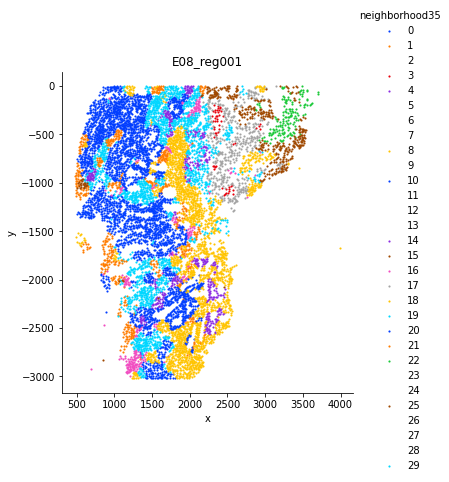

E08_reg002


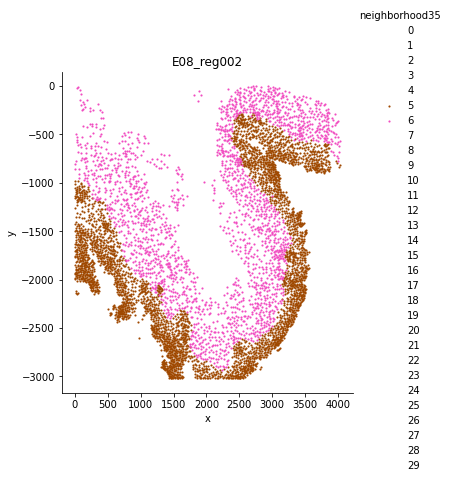

E08_reg003


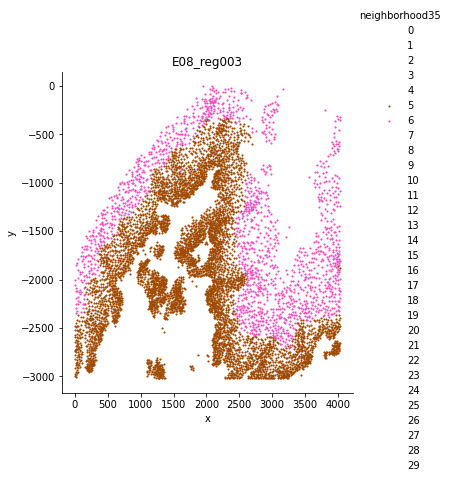

E08_reg004


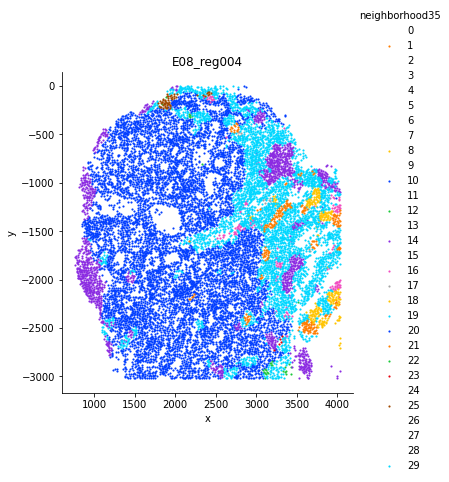

E08_reg005


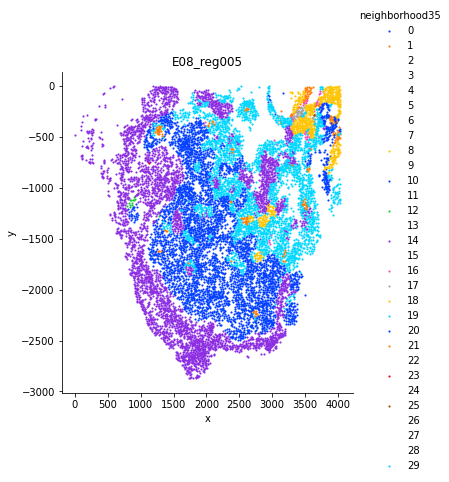

E08_reg006


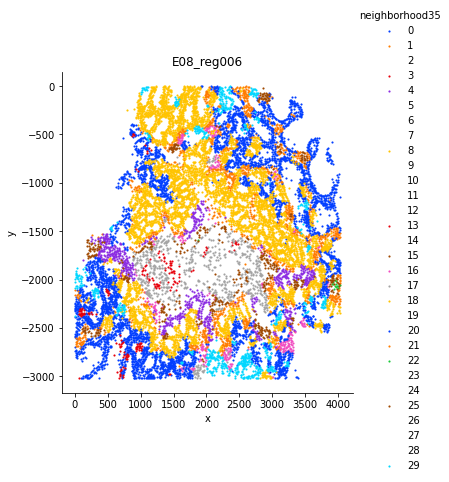

E08_reg007


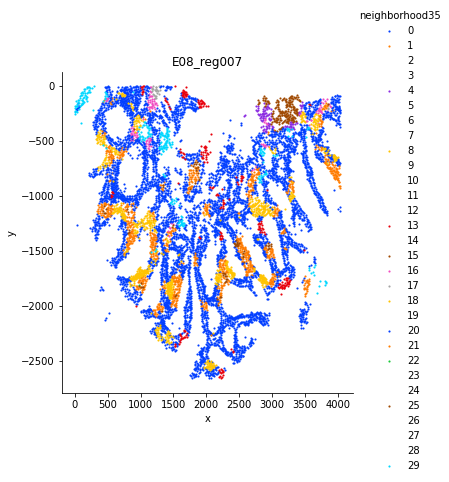

E11_reg001


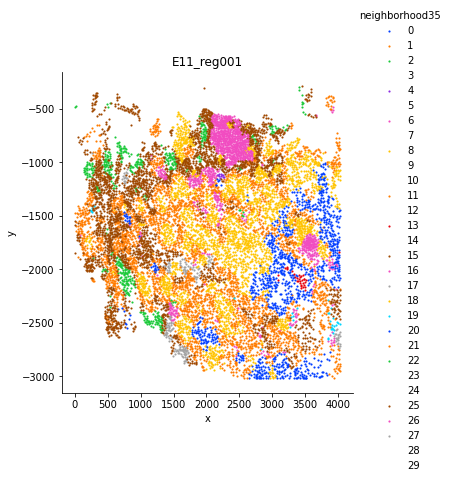

E11_reg002


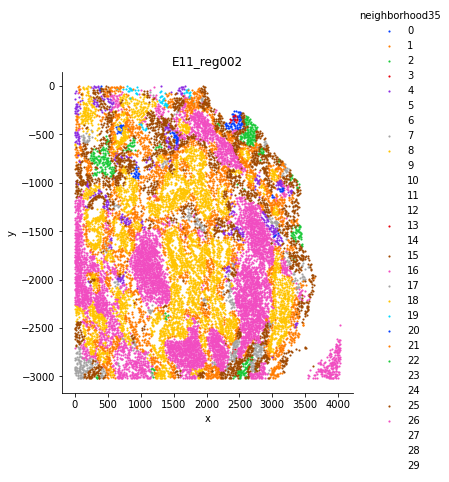

E11_reg003


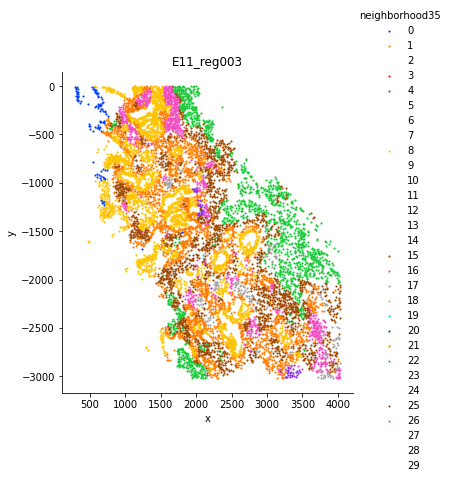

E11_reg004


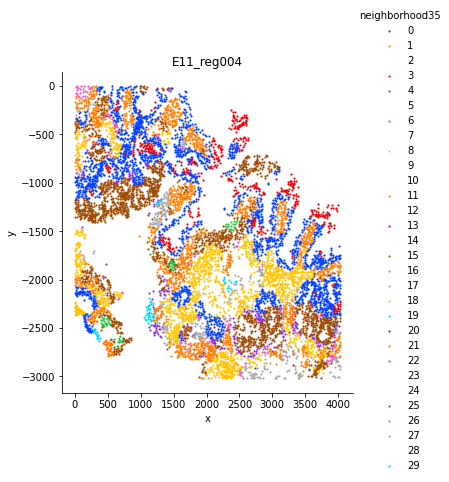

E11_reg005


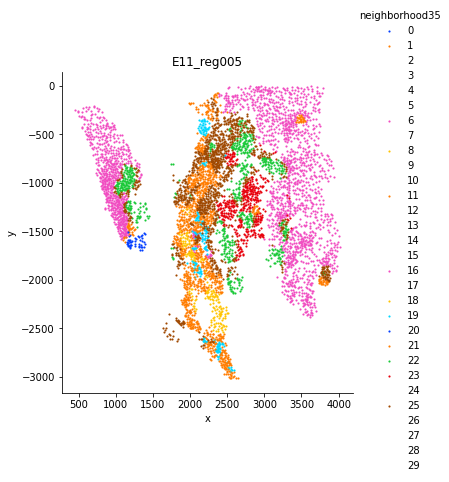

E11_reg006


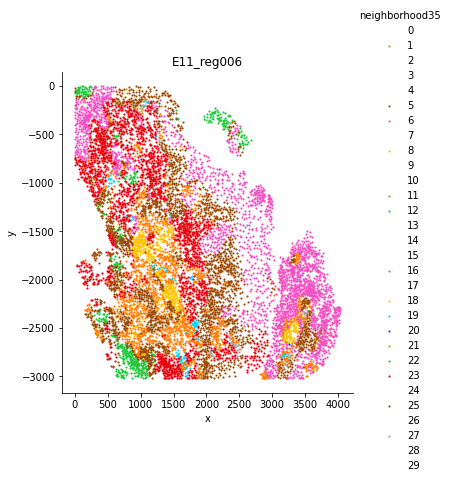

E17_reg001


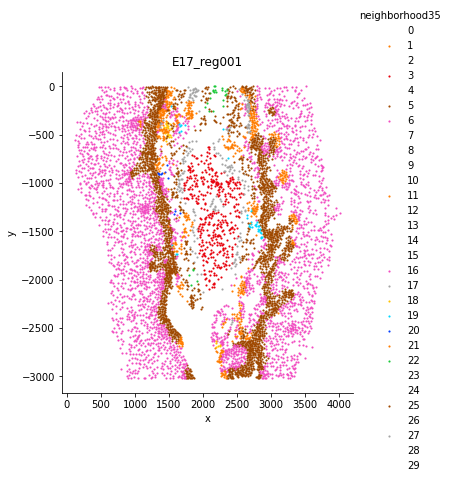

E17_reg002


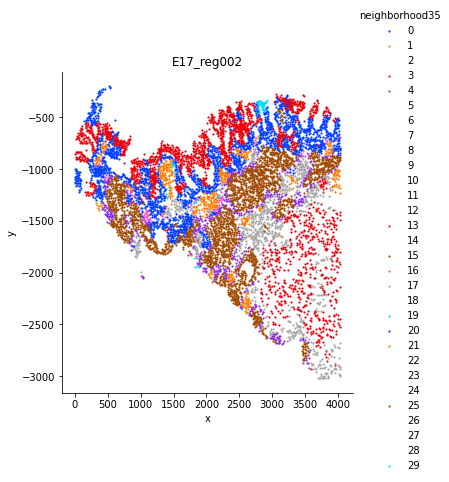

E17_reg003


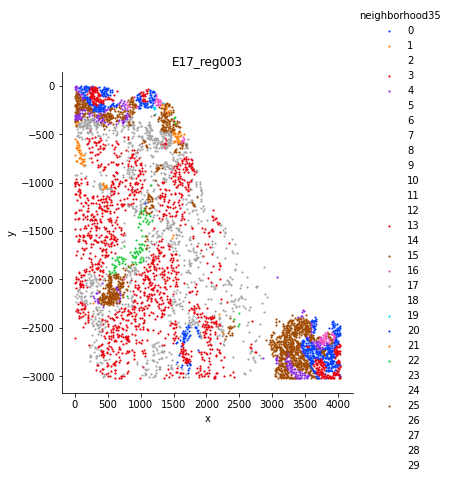

E17_reg004


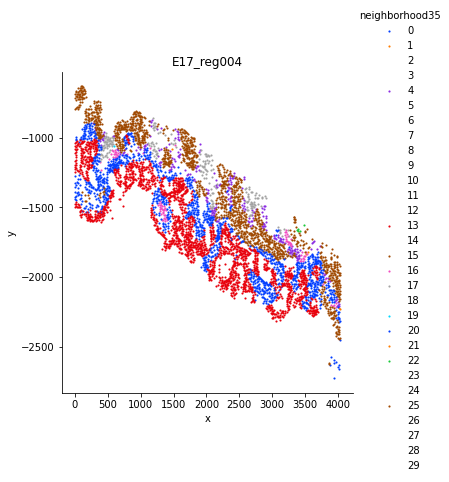

E17_reg005


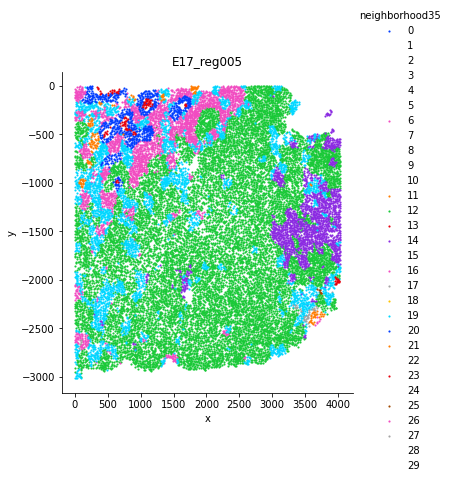

E17_reg006


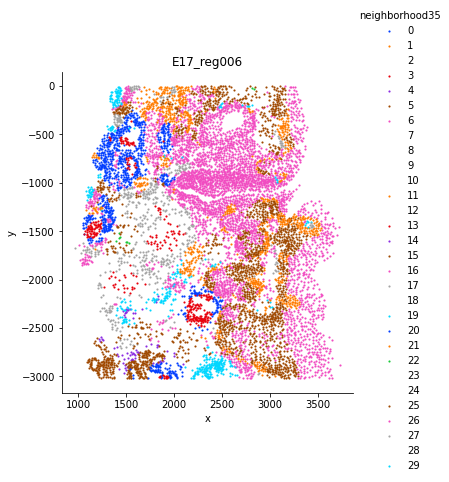

E19_reg001


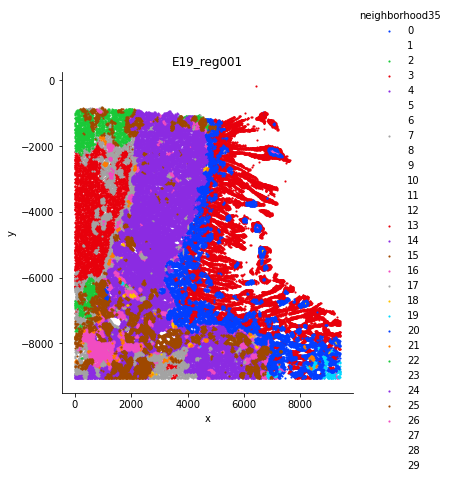

E19_reg002


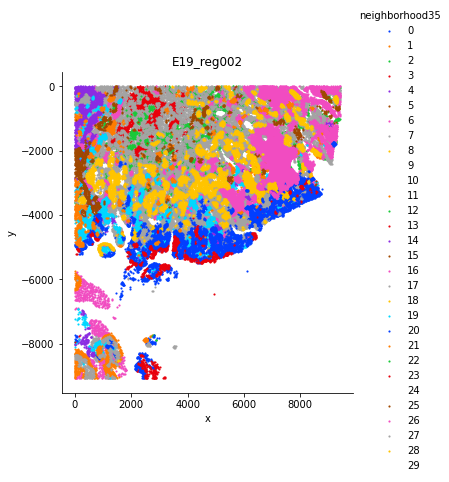

E19_reg003


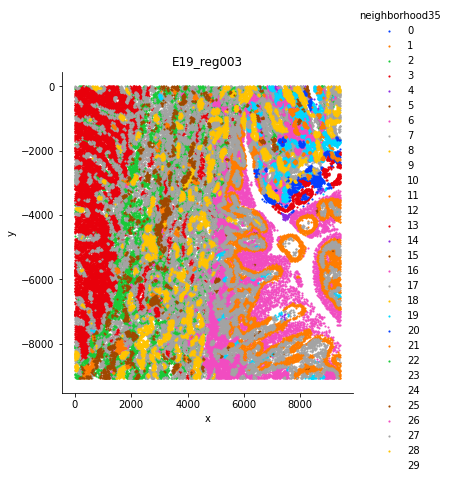

E19_reg004


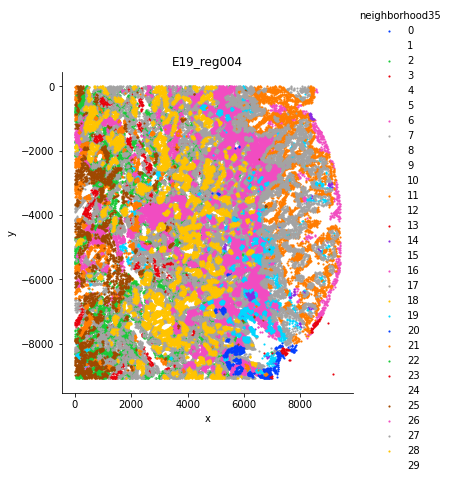

E12_reg001


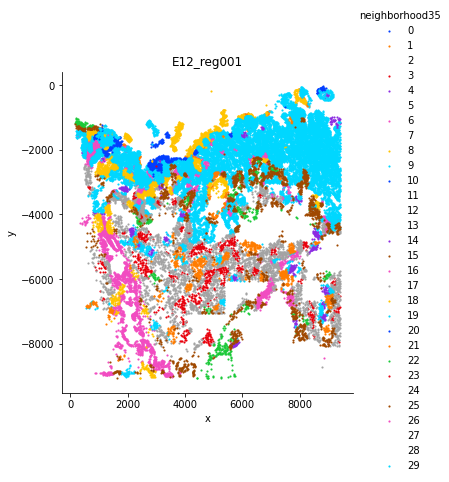

E12_reg002


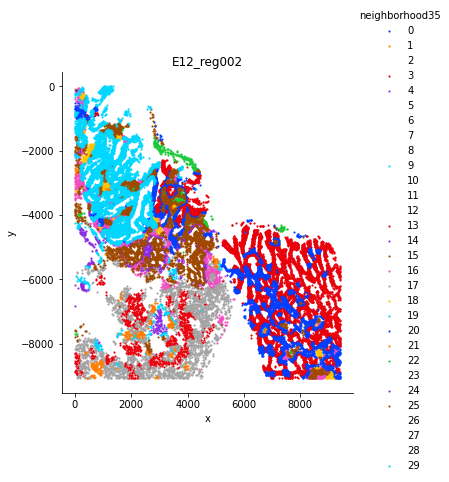

E12_reg003


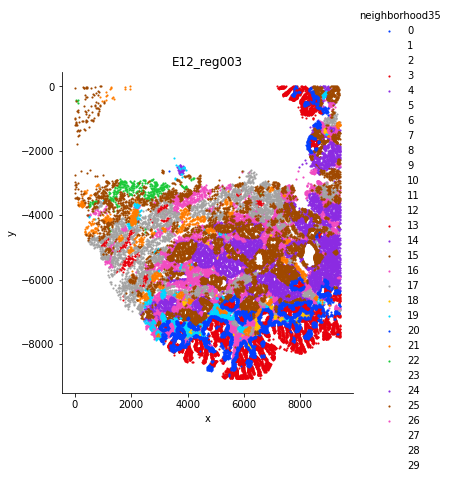

E12_reg004


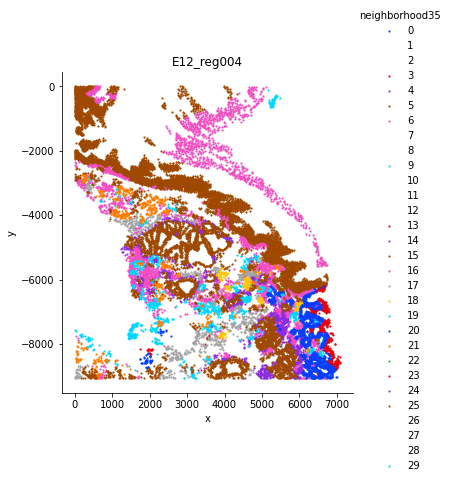

E12_reg005


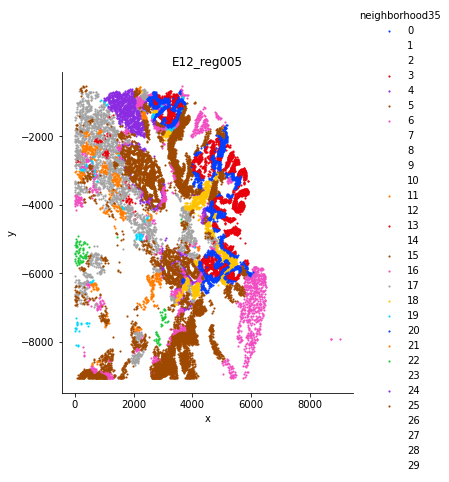

In [41]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [42]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

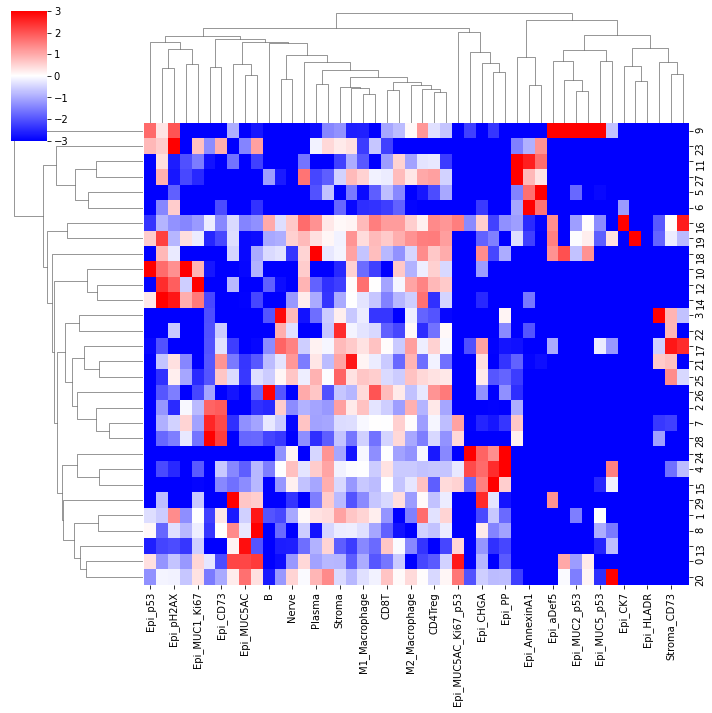

In [43]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

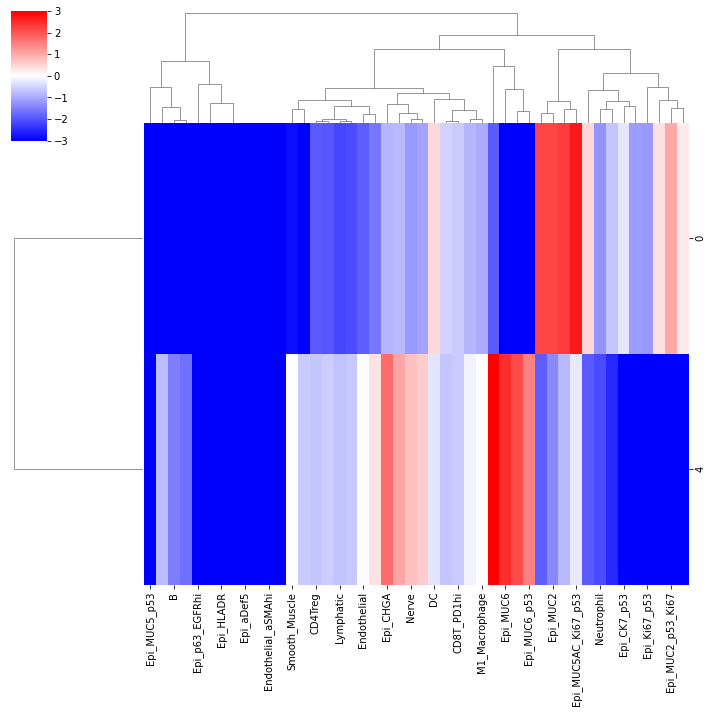

In [44]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc.iloc[[0,4,],:], vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

## 2. Condition 2 K=30 Neighborhood=20

Summary: clear structural organization of neighborhoods. Unsure if window size needs to equal to neighborhood number 

In [54]:
ori_save_path = 'analysis/codex2/'
save_path = ori_save_path + "K30N20/"

In [60]:
#Fill in based on above
k = 30
n_neighborhoods = 20
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [61]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


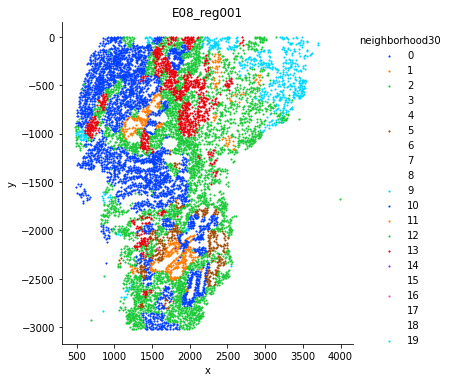

E08_reg002


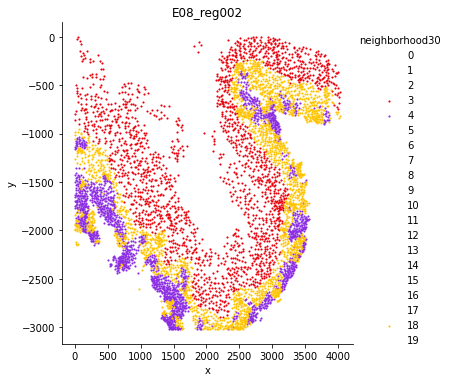

E08_reg003


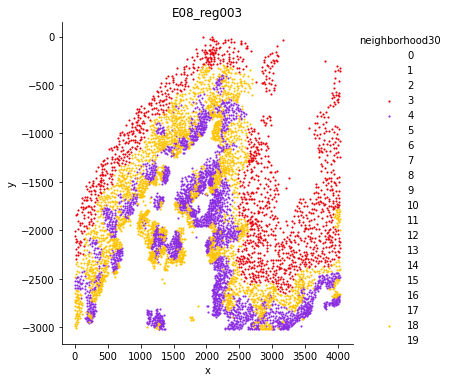

E08_reg004


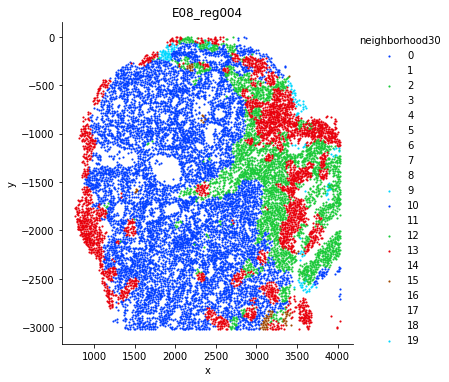

E08_reg005


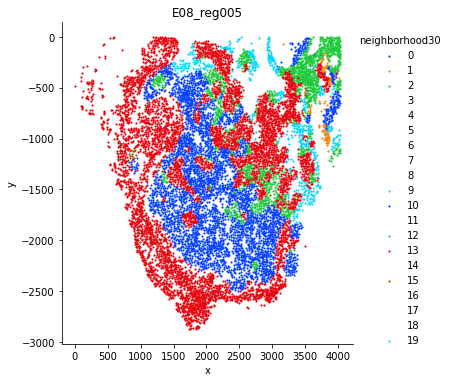

E08_reg006


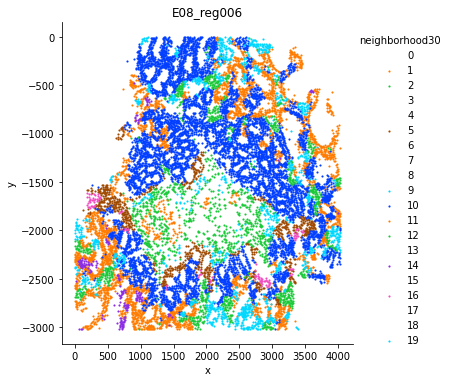

E08_reg007


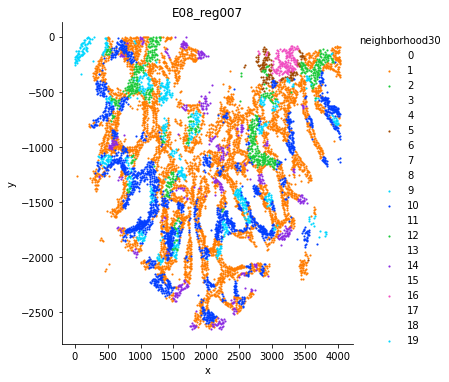

E11_reg001


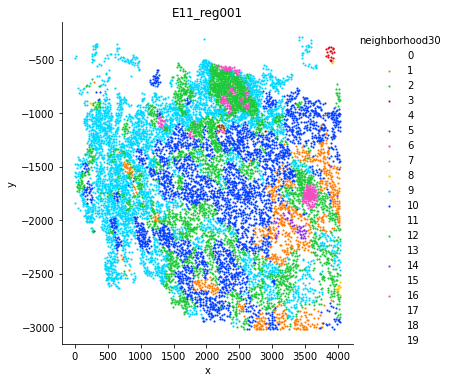

E11_reg002


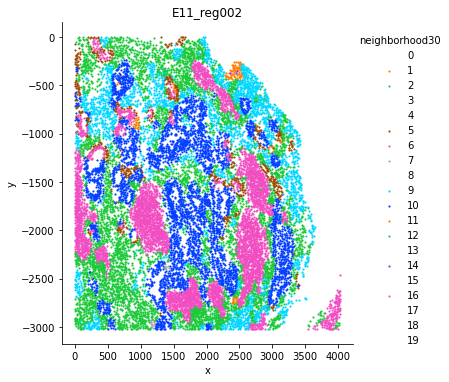

E11_reg003


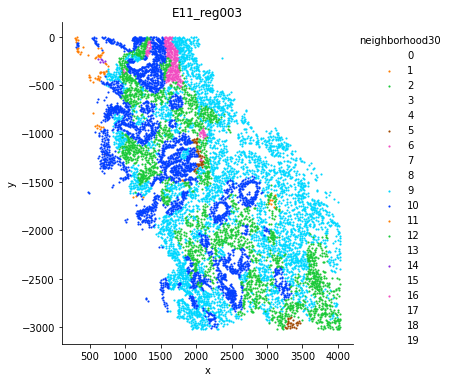

E11_reg004


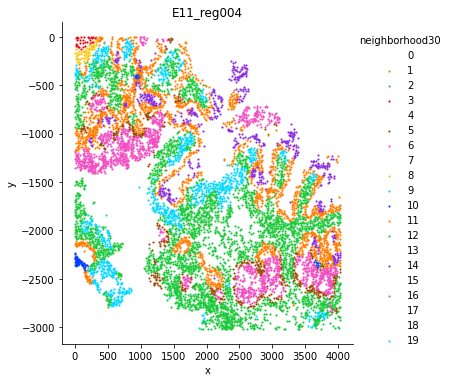

E11_reg005


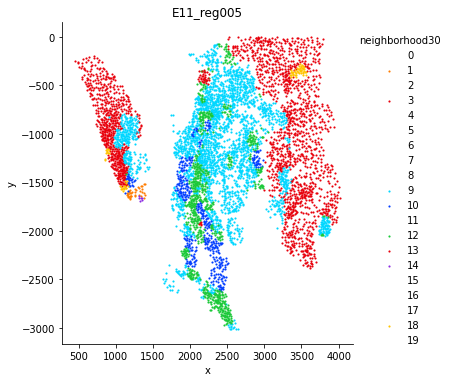

E11_reg006


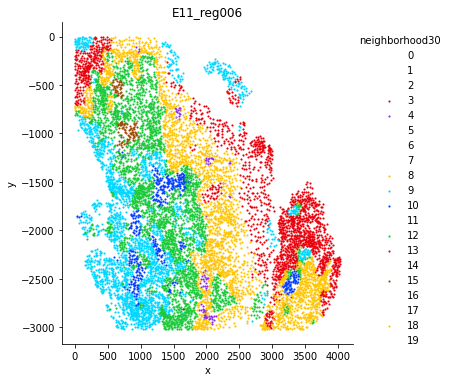

E17_reg001


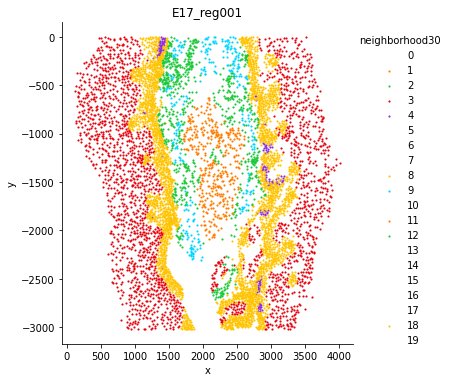

E17_reg002


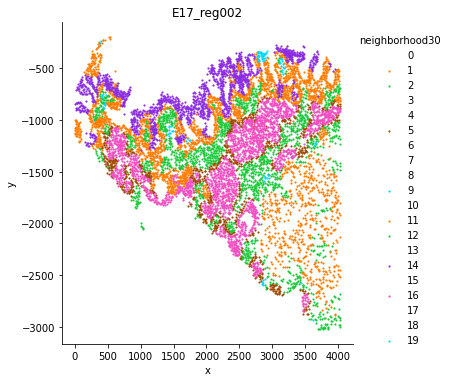

E17_reg003


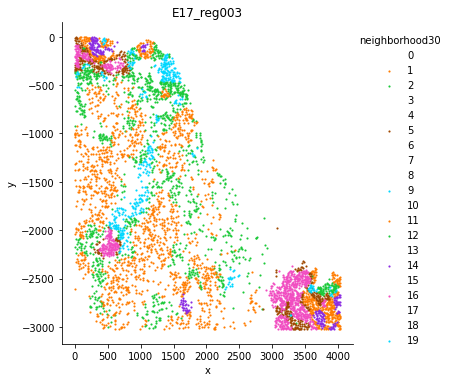

E17_reg004


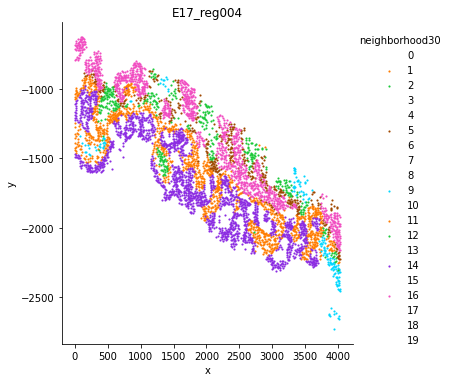

E17_reg005


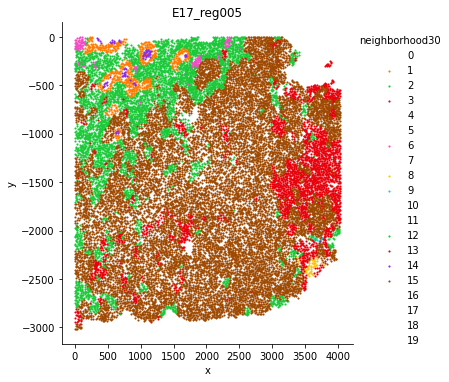

E17_reg006


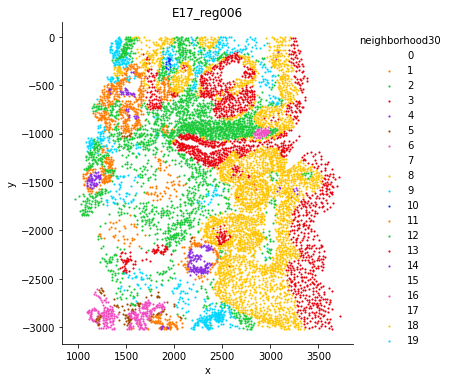

E19_reg001


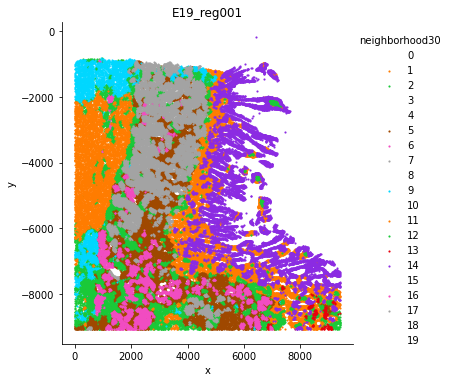

E19_reg002


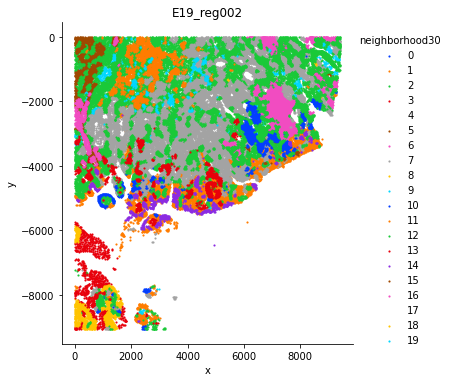

E19_reg003


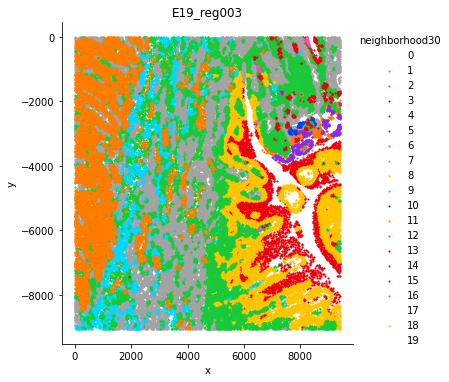

E19_reg004


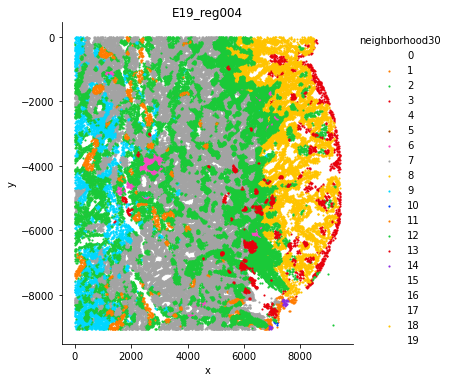

E12_reg001


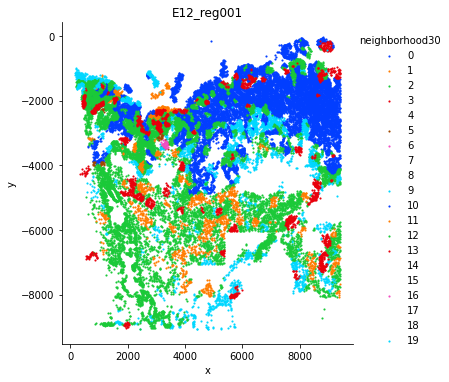

E12_reg002


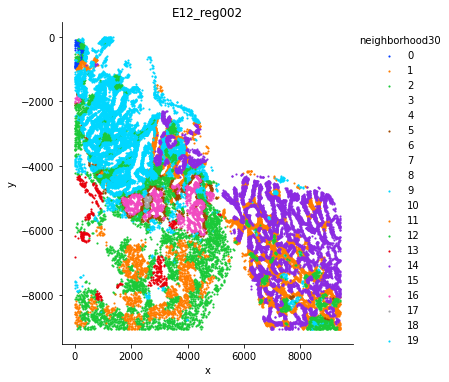

E12_reg003


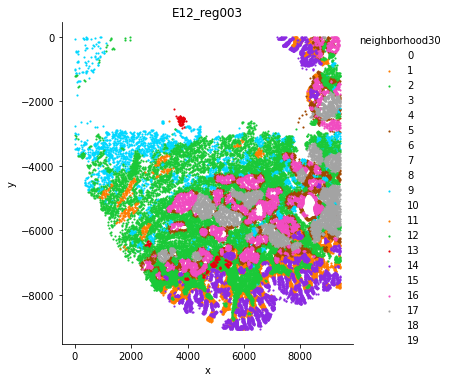

E12_reg004


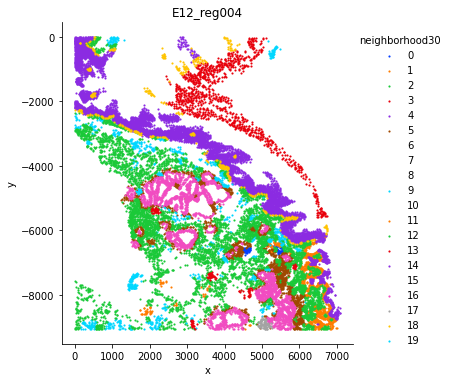

E12_reg005


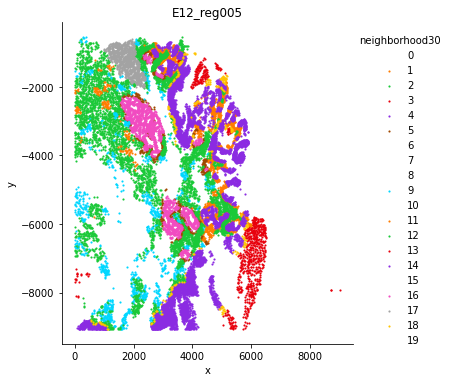

In [62]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [63]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

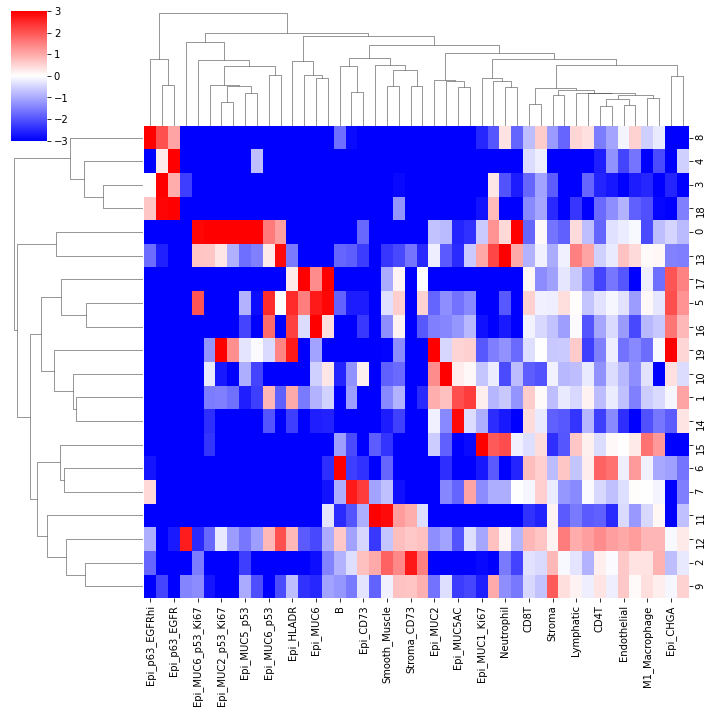

In [64]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

## 3. Condition K = 30 Neighborhood = 30

Summary: 

In [70]:
ori_save_path = 'analysis/codex2/'
save_path = ori_save_path + "K30N30/"

In [71]:
#Fill in based on above
k = 30
n_neighborhoods = 30
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [72]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


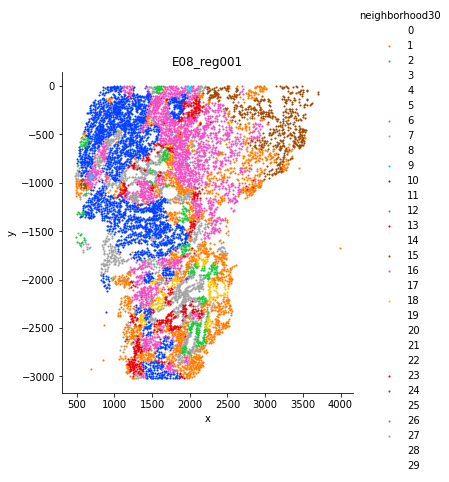

E08_reg002


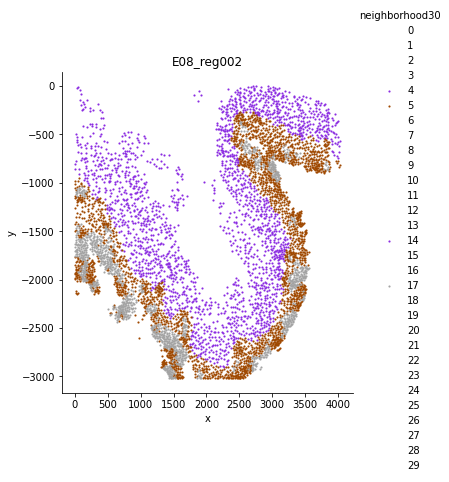

E08_reg003


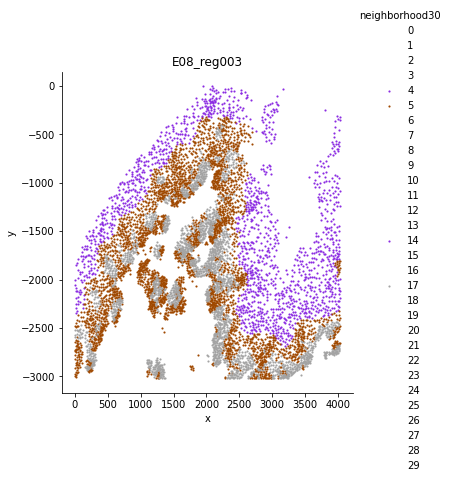

E08_reg004


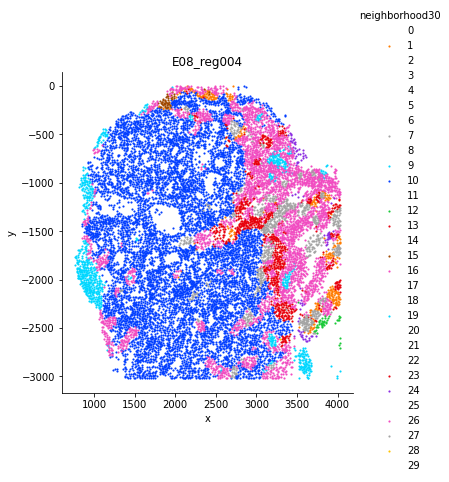

E08_reg005


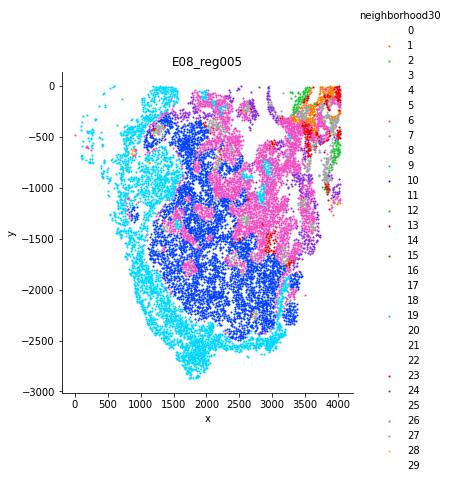

E08_reg006


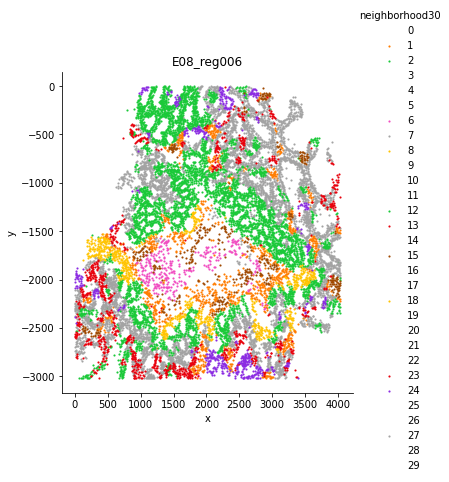

E08_reg007


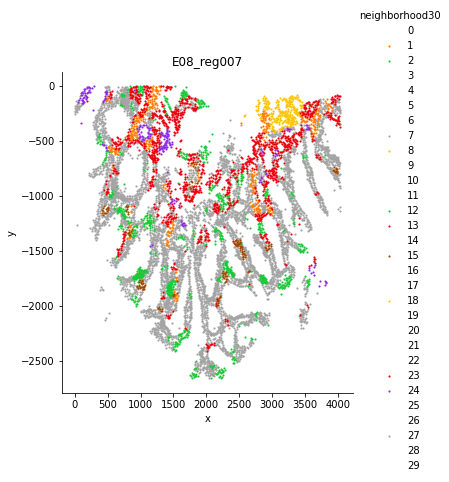

E11_reg001


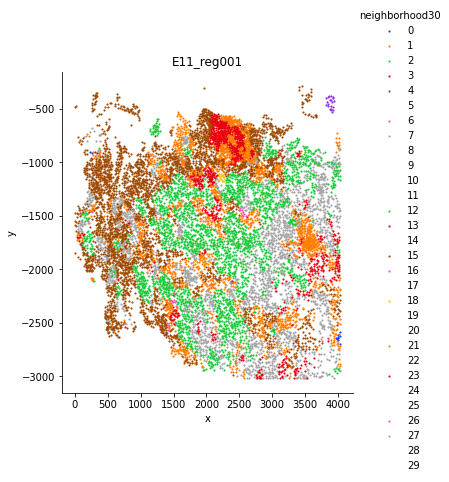

E11_reg002


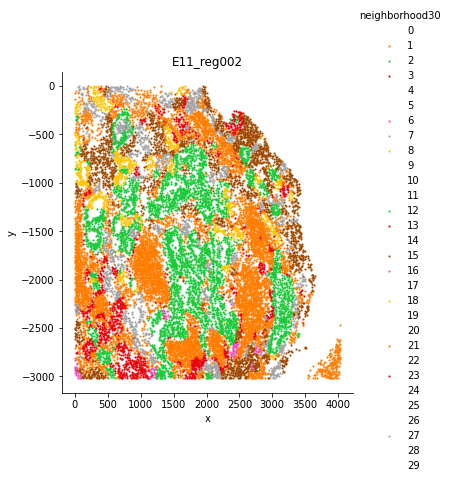

E11_reg003


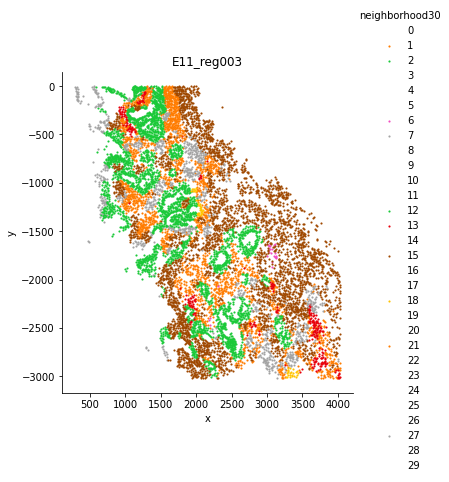

E11_reg004


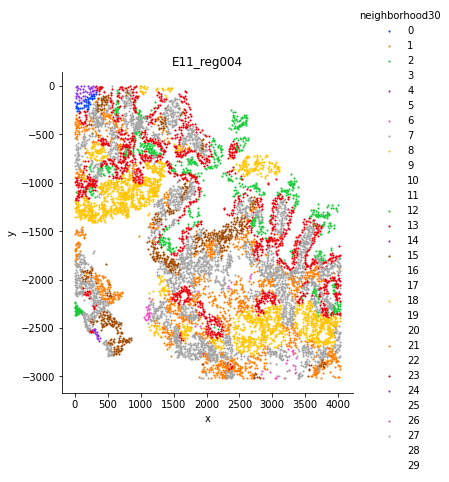

E11_reg005


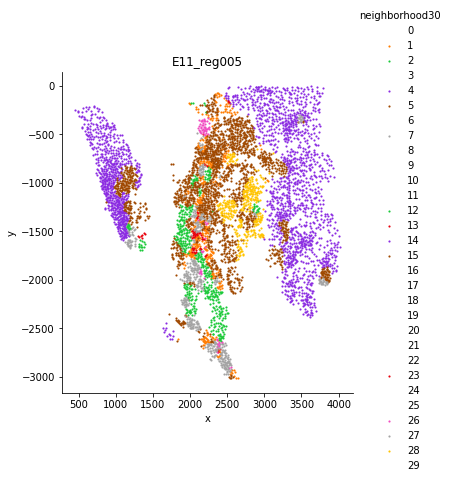

E11_reg006


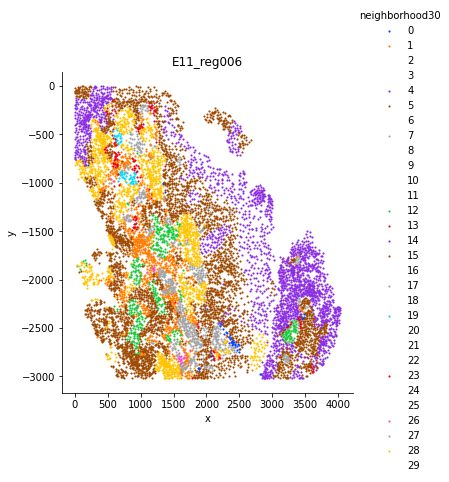

E17_reg001


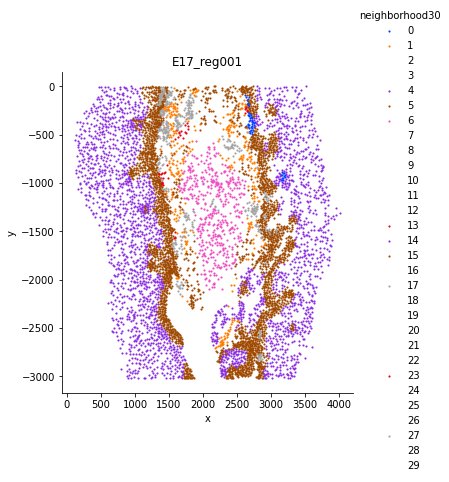

E17_reg002


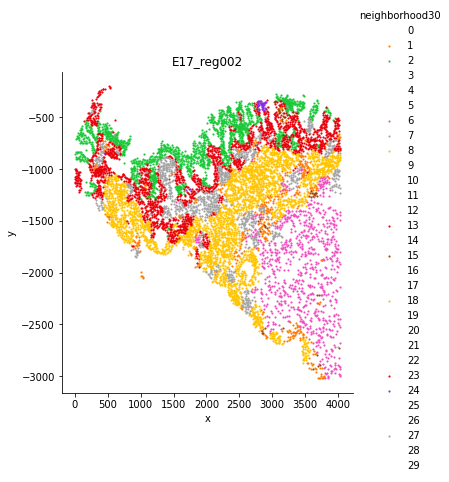

E17_reg003


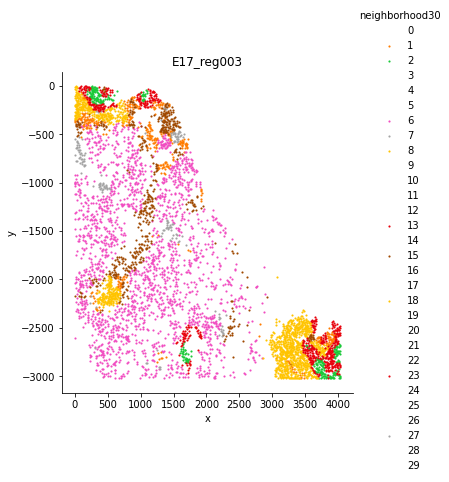

E17_reg004


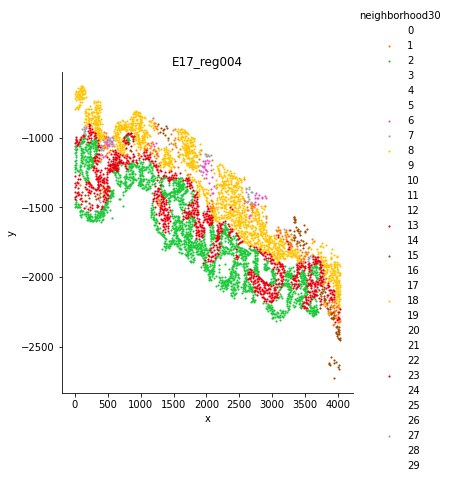

E17_reg005


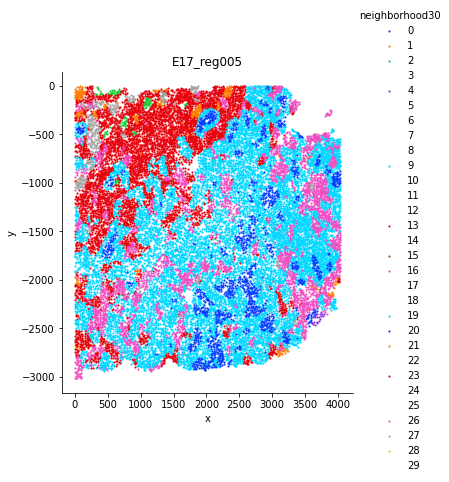

E17_reg006


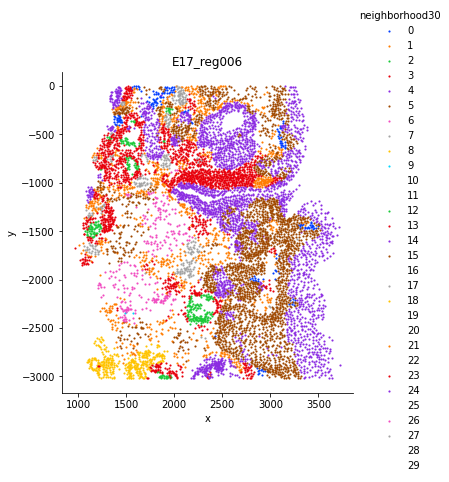

E19_reg001


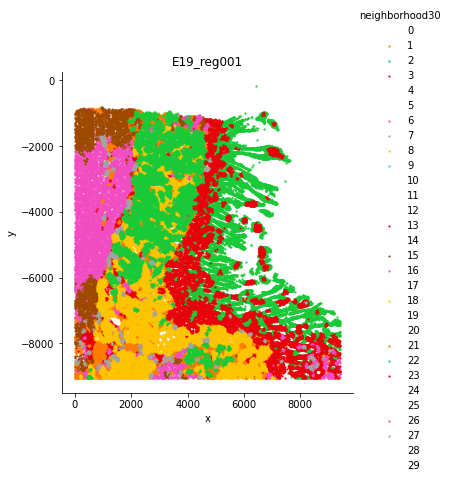

E19_reg002


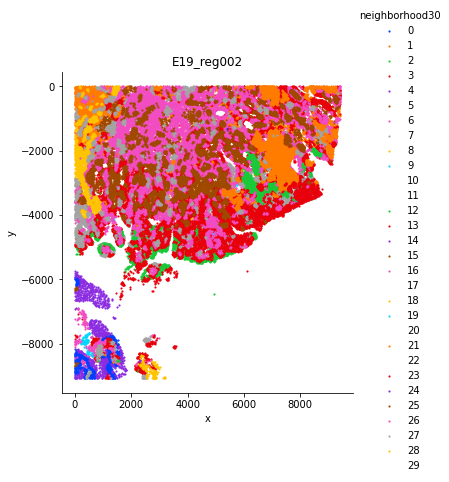

E19_reg003


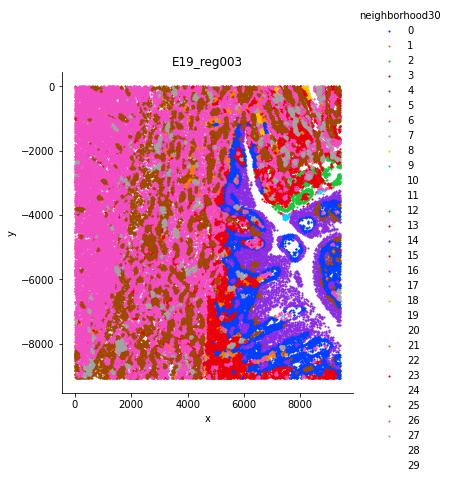

E19_reg004


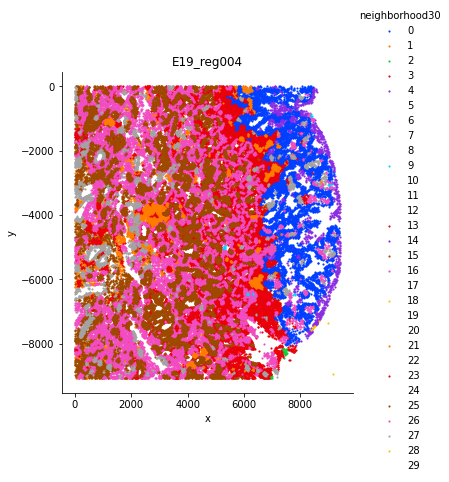

E12_reg001


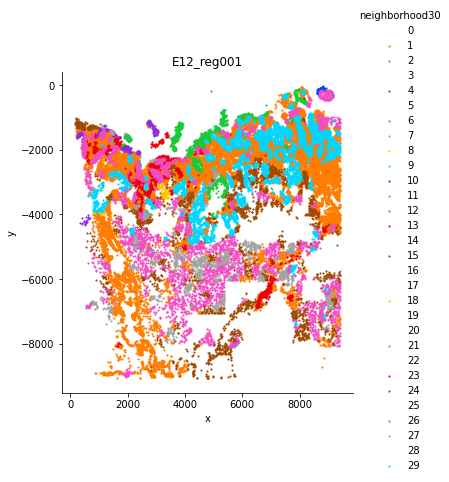

E12_reg002


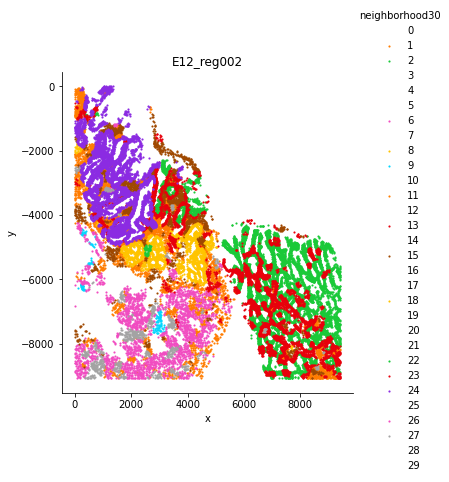

E12_reg003


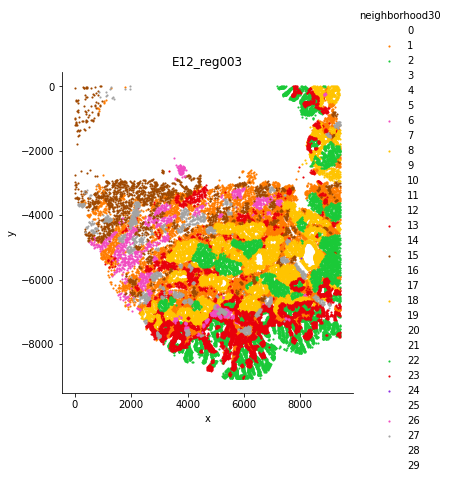

E12_reg004


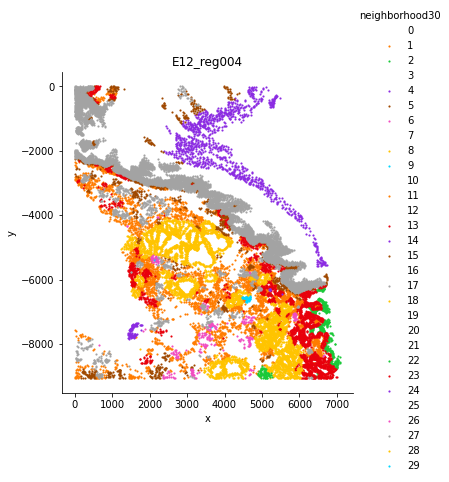

E12_reg005


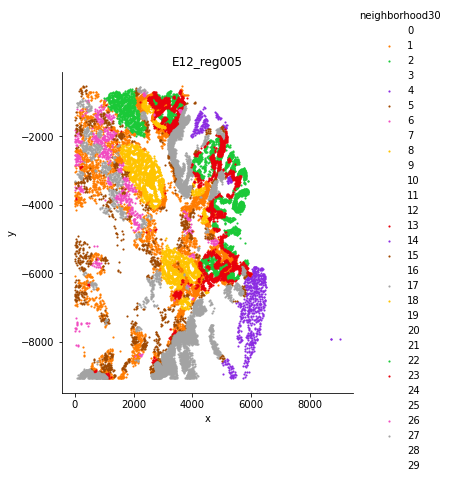

In [73]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [74]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

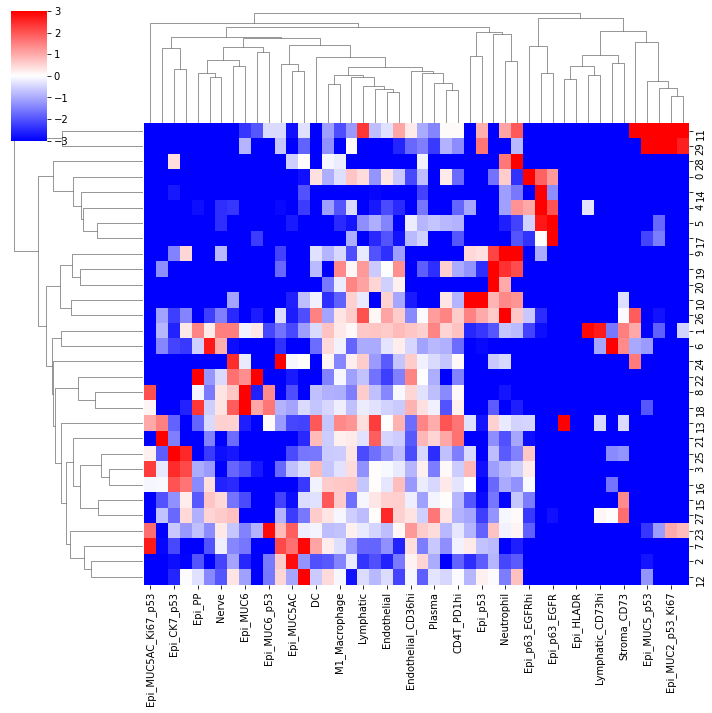

In [75]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

## 4. Condition 4 K=20 Neighborhood=20

Summary: Seem to identify sample specific neighborhoods

In [65]:
ori_save_path = 'analysis/codex2/'
save_path = ori_save_path + "K20N20_neighbors_35/"

In [66]:
#Fill in based on above
k = 20
n_neighborhoods = 20
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [67]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


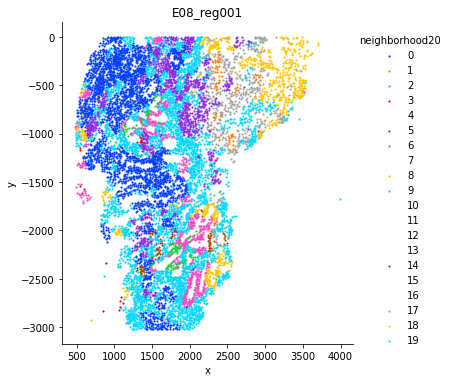

E08_reg002


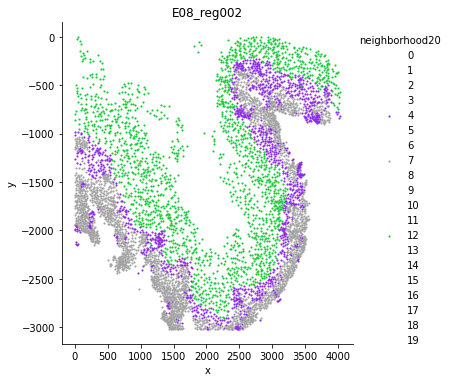

E08_reg003


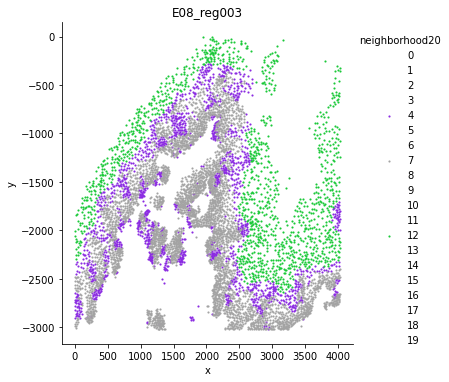

E08_reg004


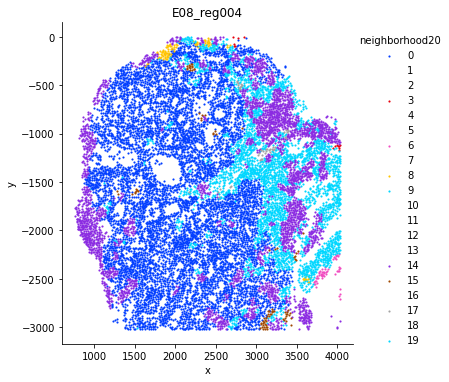

E08_reg005


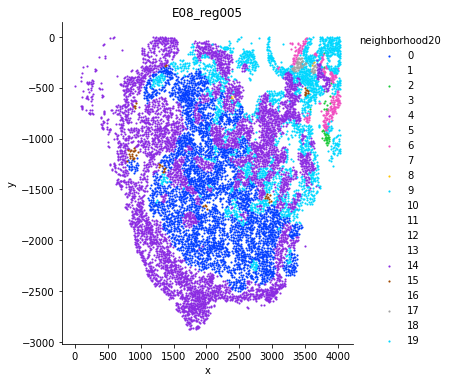

E08_reg006


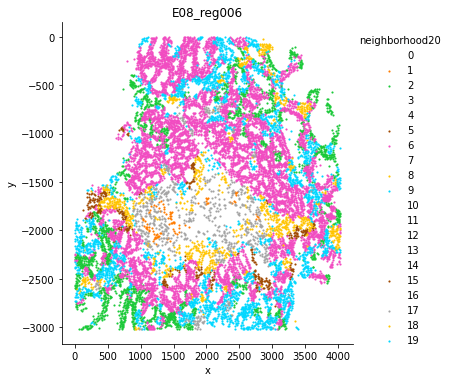

E08_reg007


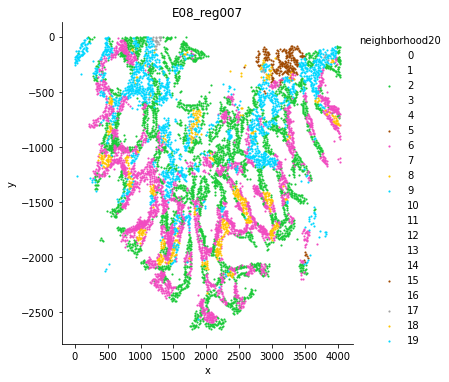

E11_reg001


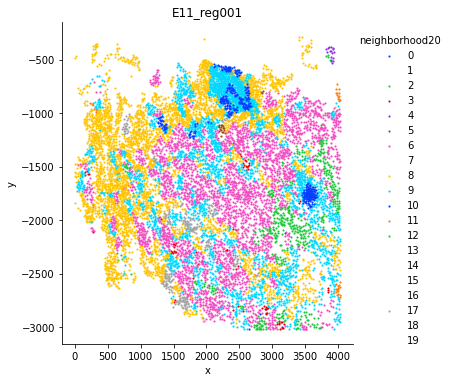

E11_reg002


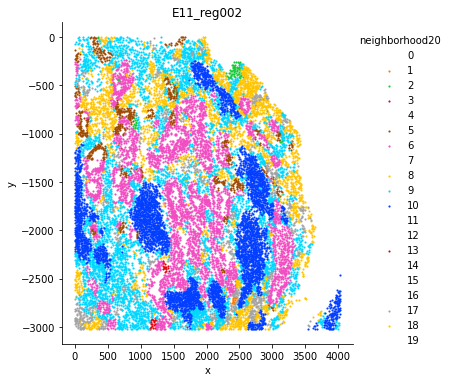

E11_reg003


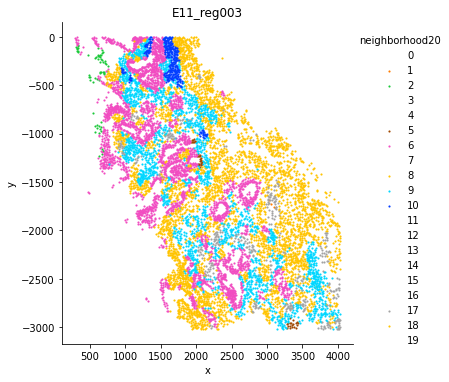

E11_reg004


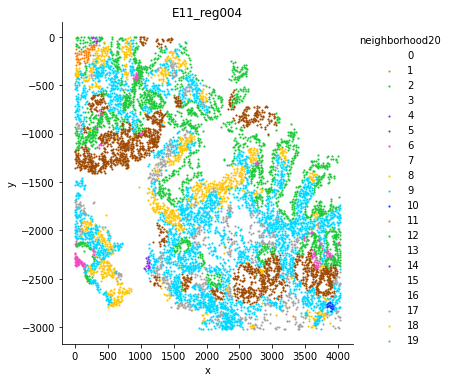

E11_reg005


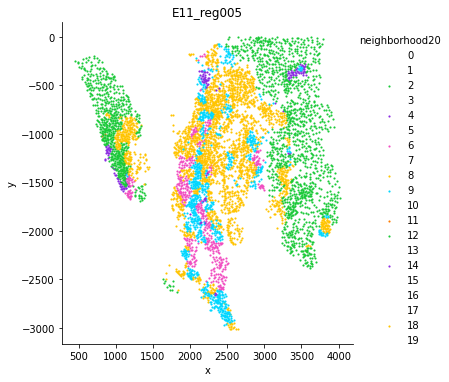

E11_reg006


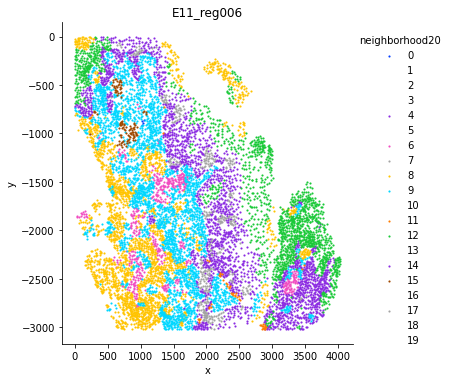

E17_reg001


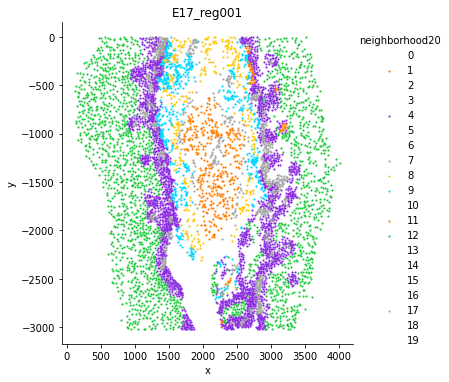

E17_reg002


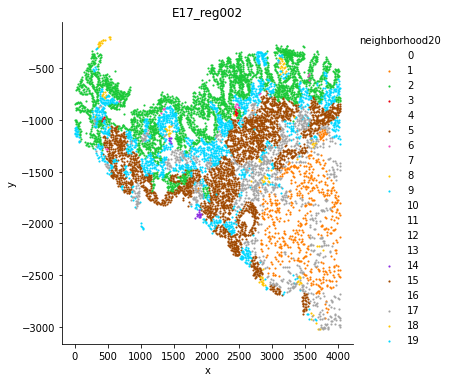

E17_reg003


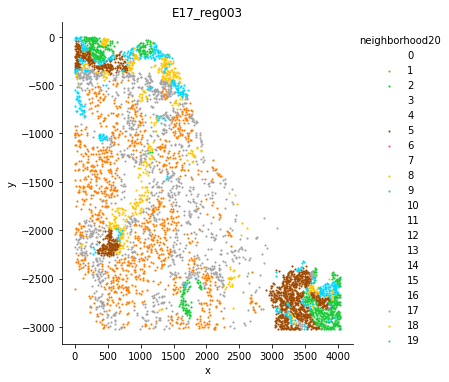

E17_reg004


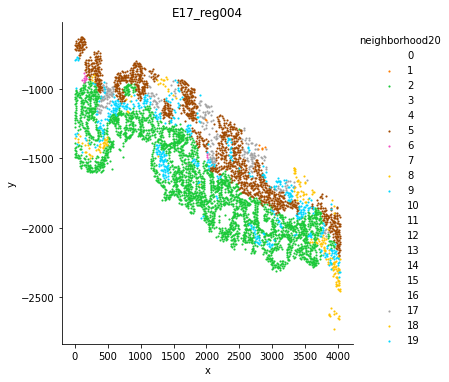

E17_reg005


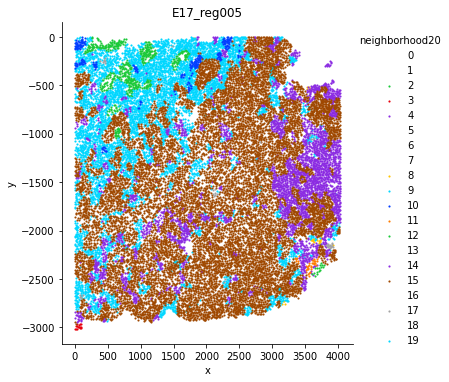

E17_reg006


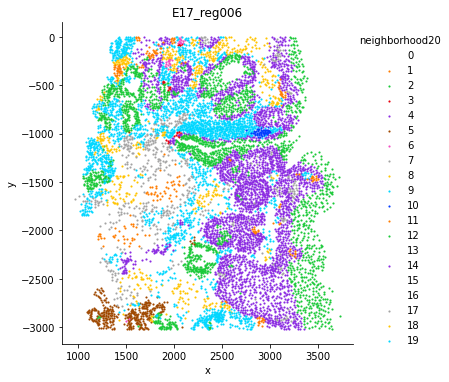

E19_reg001


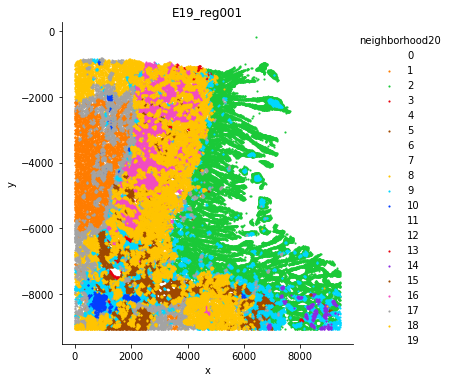

E19_reg002


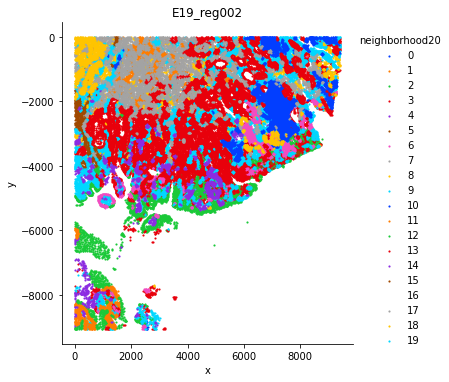

E19_reg003


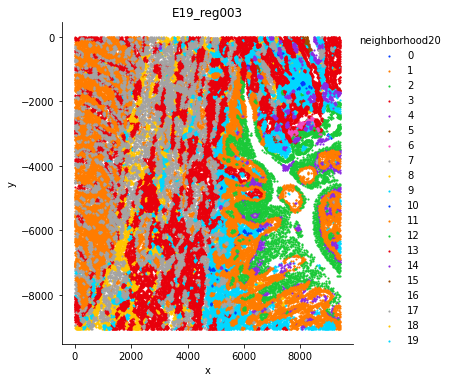

E19_reg004


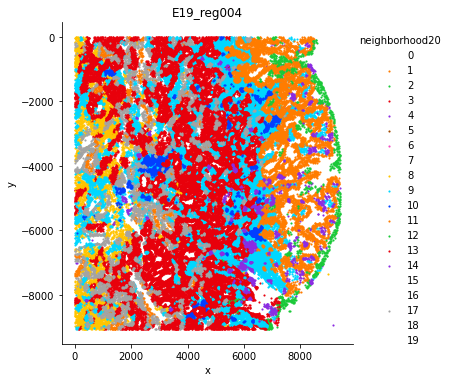

E12_reg001


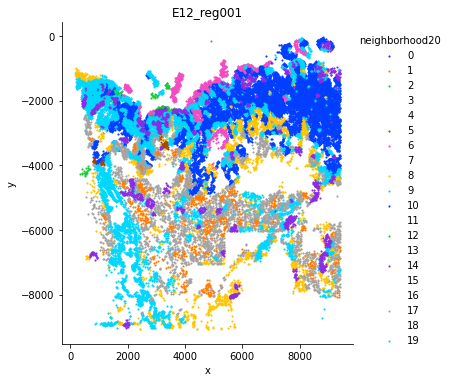

E12_reg002


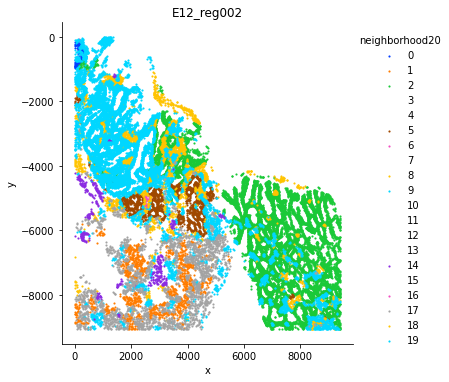

E12_reg003


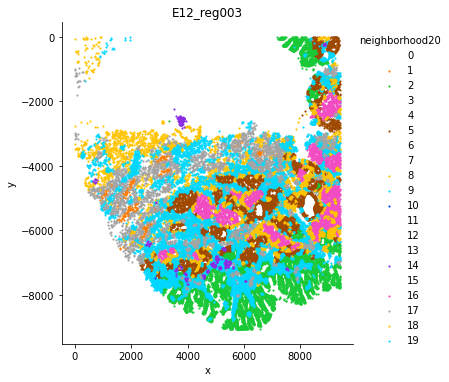

E12_reg004


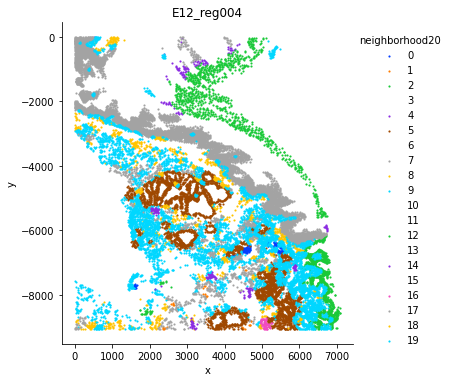

E12_reg005


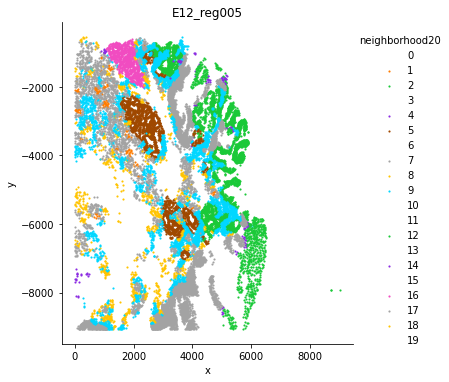

In [68]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [69]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

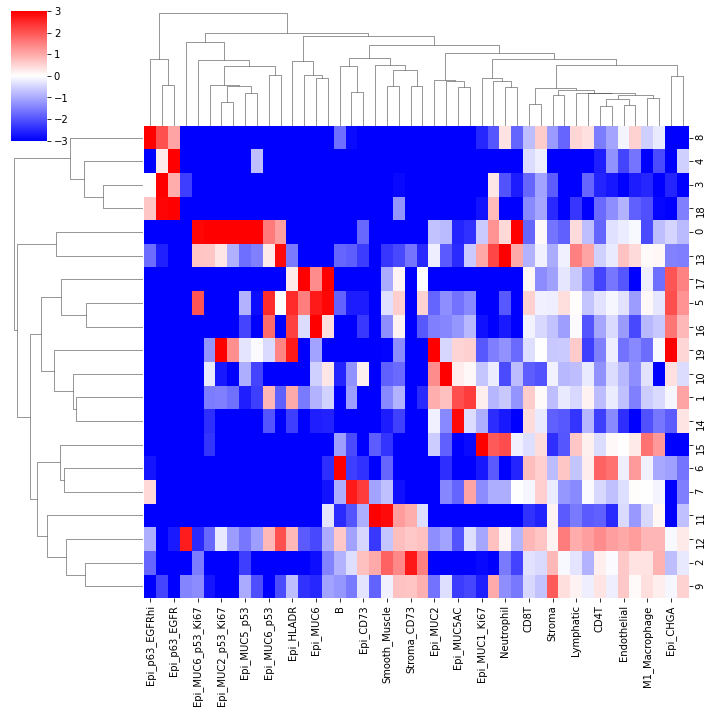

In [64]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

### Conclusion: the enrichment is still not as specific
### Strategy: reduce neighborhood size

In [77]:
ks = [15, 20, 25]

In [78]:
#Import Data
n_neighbors = max(ks)
#Get each region
tissues = [get_windows(job,n_neighbors) for job in tissue_chunks]

Starting: 1/28 : E08_reg001
Finishing: 1/28 : E08_reg001 0.053720712661743164 30200.443517923355
Starting: 2/28 : E08_reg002
Finishing: 2/28 : E08_reg002 0.02921915054321289 30200.478402137756
Starting: 3/28 : E08_reg003
Finishing: 3/28 : E08_reg003 0.03725004196166992 30200.516450881958
Starting: 4/28 : E08_reg004
Finishing: 4/28 : E08_reg004 0.07751226425170898 30200.59512114525
Starting: 5/28 : E08_reg005
Finishing: 5/28 : E08_reg005 0.05734086036682129 30200.6544880867
Starting: 6/28 : E08_reg006
Finishing: 6/28 : E08_reg006 0.08316588401794434 30200.739115953445
Starting: 7/28 : E08_reg007
Finishing: 7/28 : E08_reg007 0.04236197471618652 30200.783836126328
Starting: 8/28 : E11_reg001
Finishing: 8/28 : E11_reg001 0.0580449104309082 30200.84318089485
Starting: 9/28 : E11_reg002
Finishing: 9/28 : E11_reg002 0.09699583053588867 30200.941240787506
Starting: 10/28 : E11_reg003
Finishing: 10/28 : E11_reg003 0.04895210266113281 30200.993067979813
Starting: 11/28 : E11_reg004
Finishing: 11

In [79]:
#Loop over k to compute neighborhoods
out_dict = {}
for k in ks:
    for neighbors,job in zip(tissues,tissue_chunks):

        chunk = np.arange(len(neighbors))#indices
        tissue_name = job[2]
        indices = job[3]
        window = values[neighbors[chunk,:k].flatten()].reshape(len(chunk),k,len(sum_cols)).sum(axis = 1)
        out_dict[(tissue_name,k)] = (window.astype(np.float16),indices)
        
windows = {}
for k in ks:
   
    window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
    window = window.loc[cells.index.values]
    window = pd.concat([cells[keep_cols],window],1)
    windows[k] = window

## 5. Condition 5 K=20 Neighborhood=20

In [80]:
ori_save_path = 'analysis/codex2/'
save_path = ori_save_path + "K20N20_neighbors_25/"

In [81]:
#Fill in based on above
k = 20
n_neighborhoods = 20
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [82]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


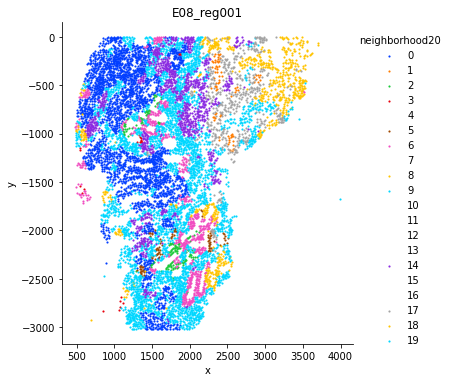

E08_reg002


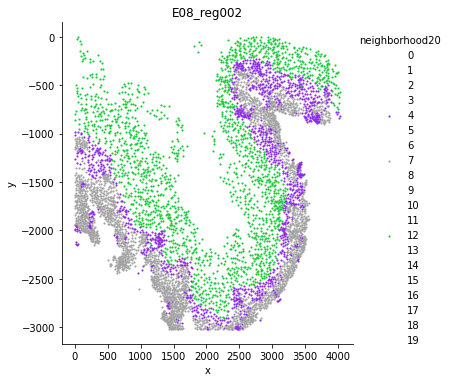

E08_reg003


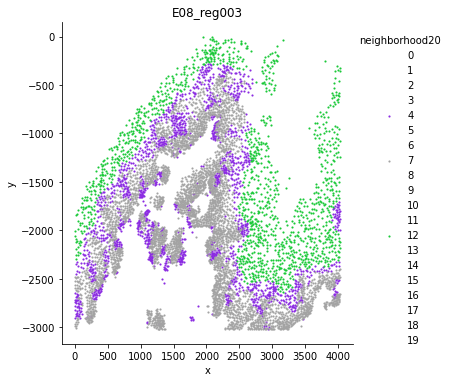

E08_reg004


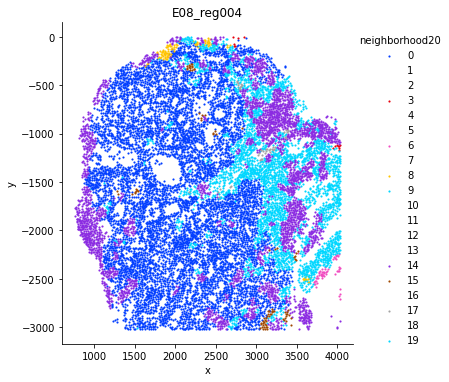

E08_reg005


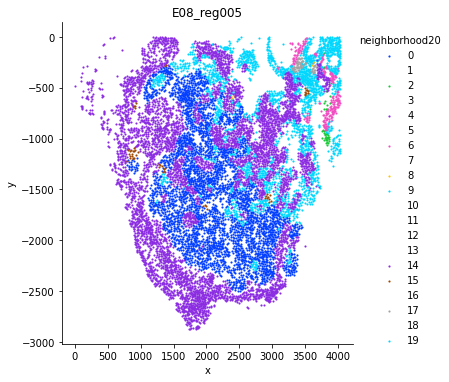

E08_reg006


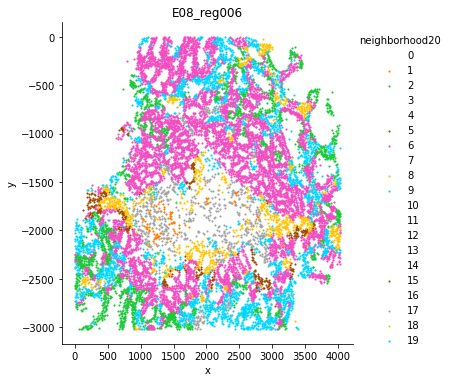

E08_reg007


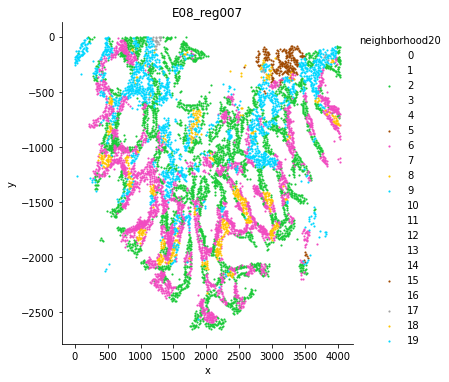

E11_reg001


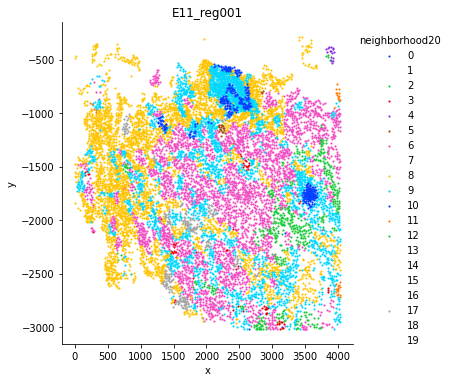

E11_reg002


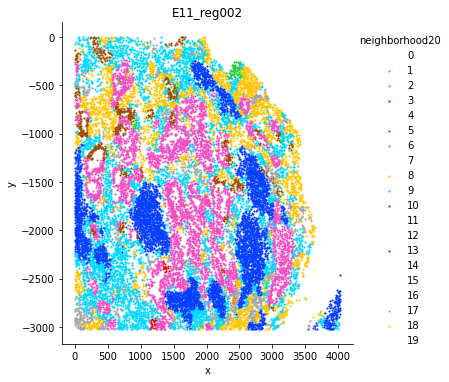

E11_reg003


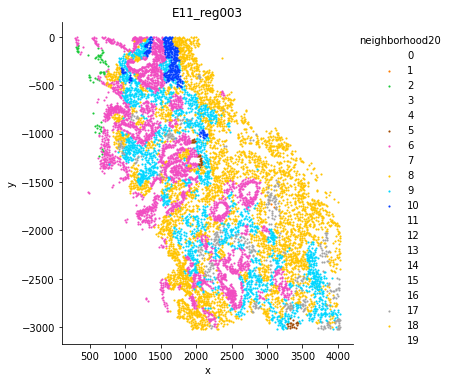

E11_reg004


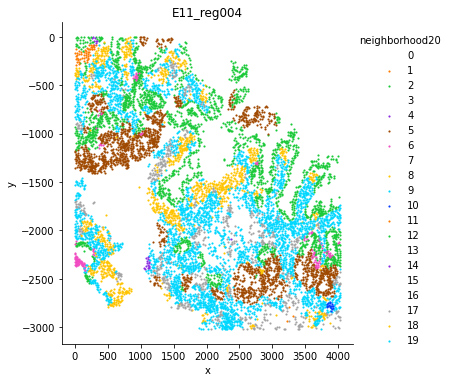

E11_reg005


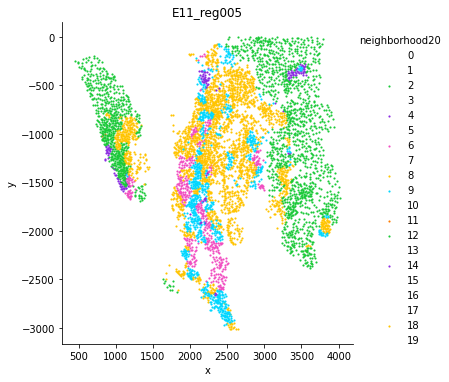

E11_reg006


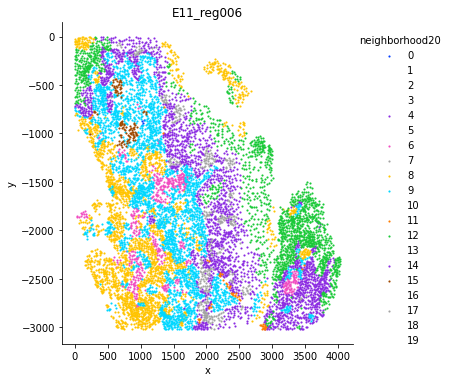

E17_reg001


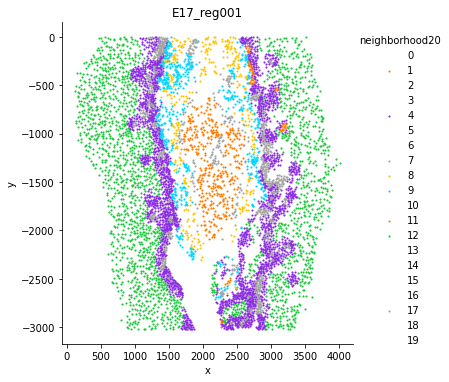

E17_reg002


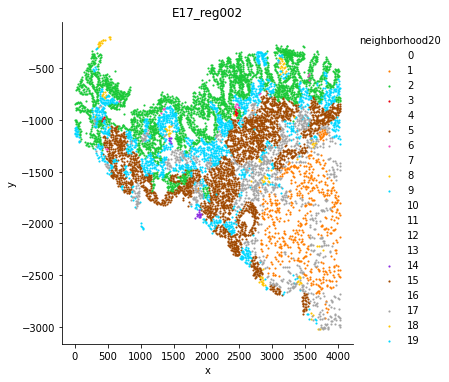

E17_reg003


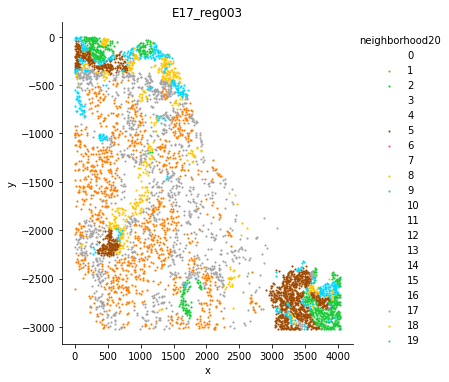

E17_reg004


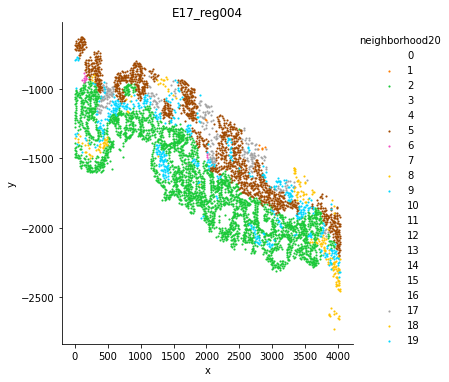

E17_reg005


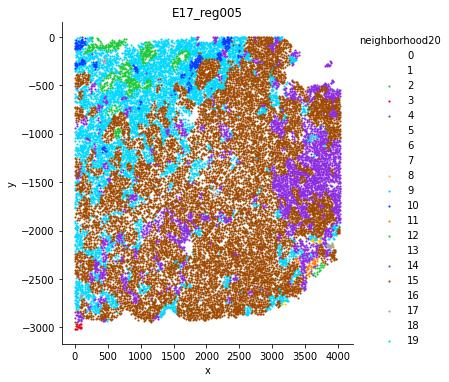

E17_reg006


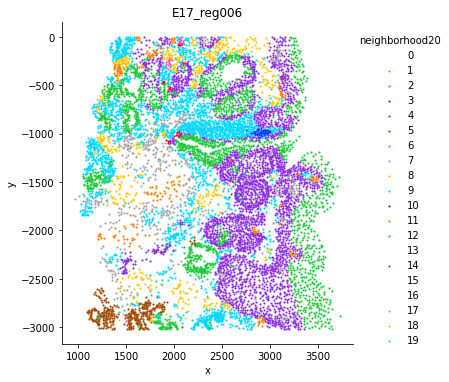

E19_reg001


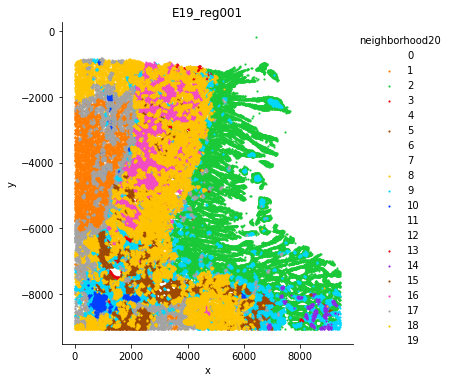

E19_reg002


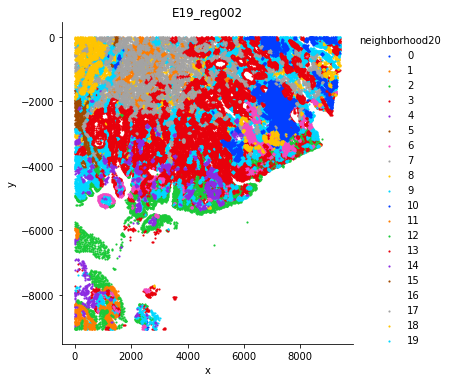

E19_reg003


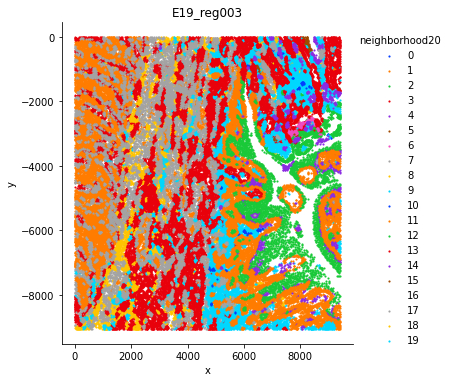

E19_reg004


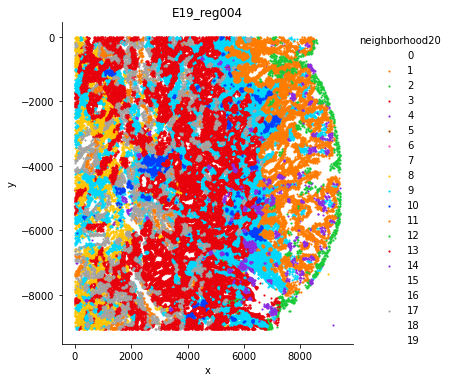

E12_reg001


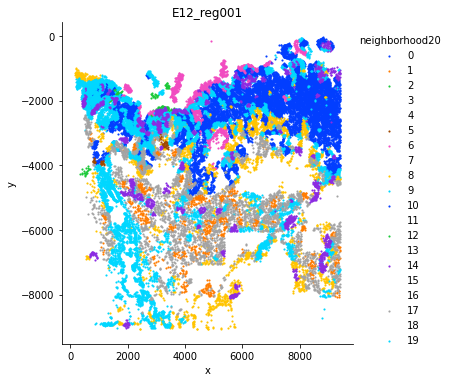

E12_reg002


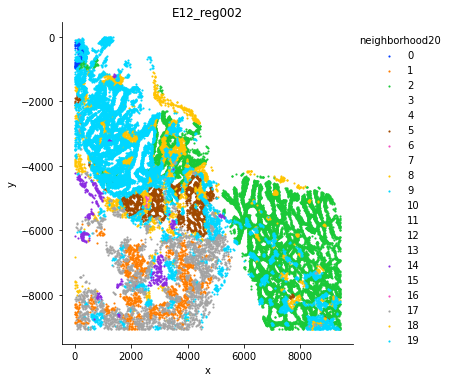

E12_reg003


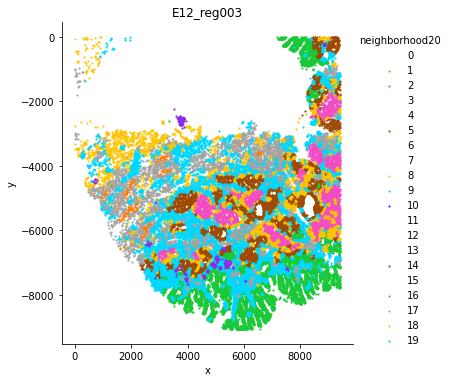

E12_reg004


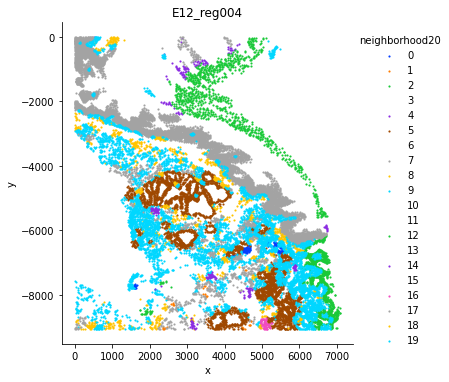

E12_reg005


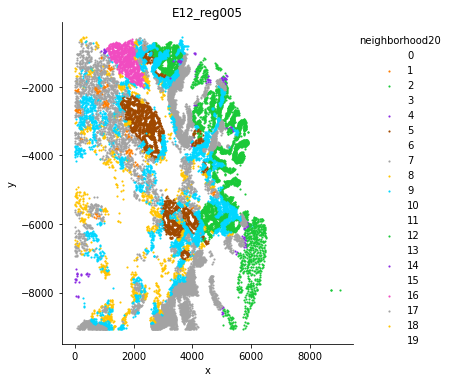

In [83]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [84]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

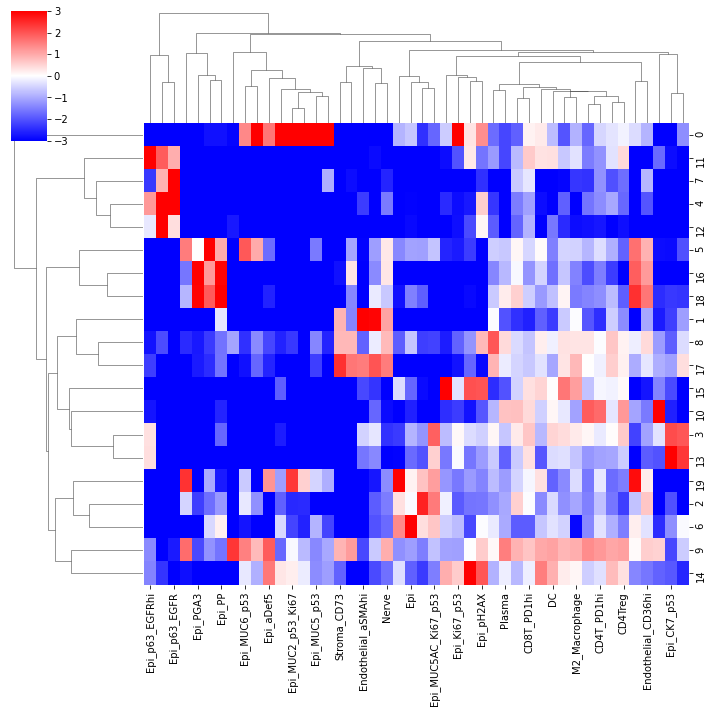

In [85]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

## 6. Condition 6 K = 15 N = 15

In [89]:
save_path = ori_save_path + "K15N15_neighbors_25/"

In [90]:
#Fill in based on above
k = 15
n_neighborhoods = 15
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [91]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


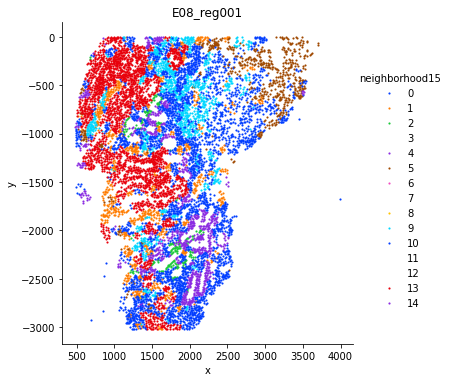

E08_reg002


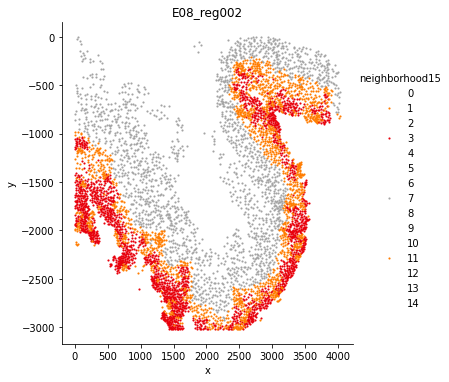

E08_reg003


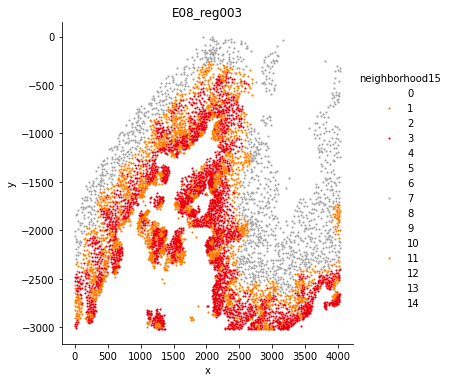

E08_reg004


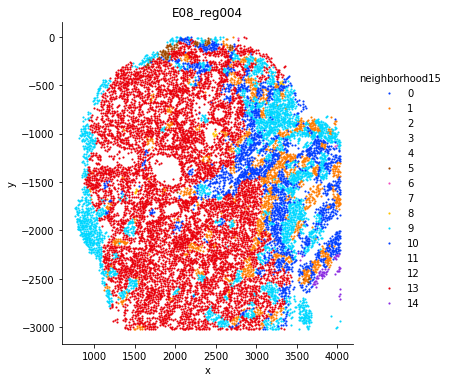

E08_reg005


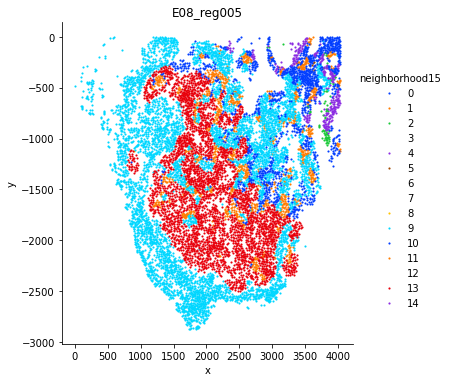

E08_reg006


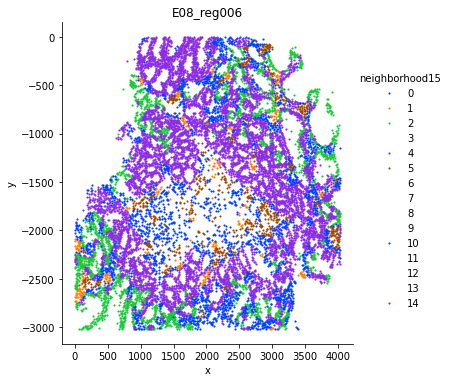

E08_reg007


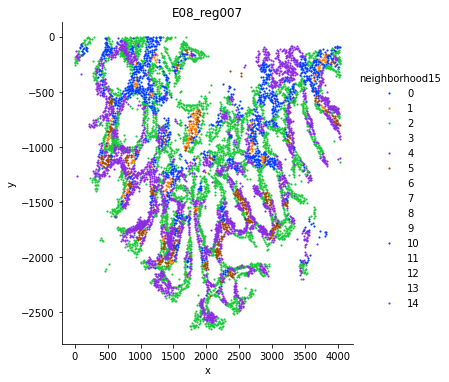

E11_reg001


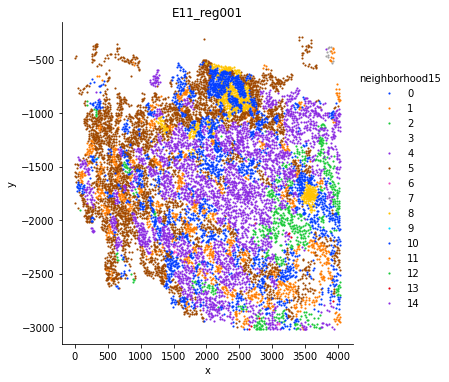

E11_reg002


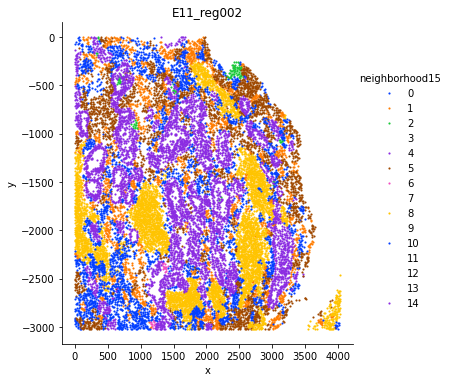

E11_reg003


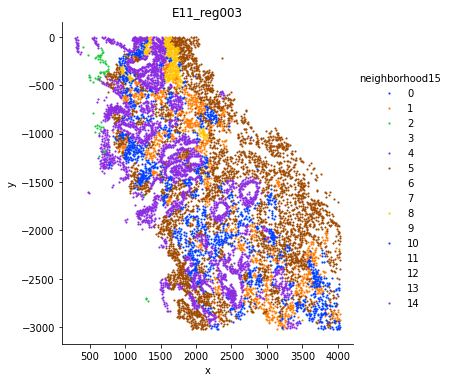

E11_reg004


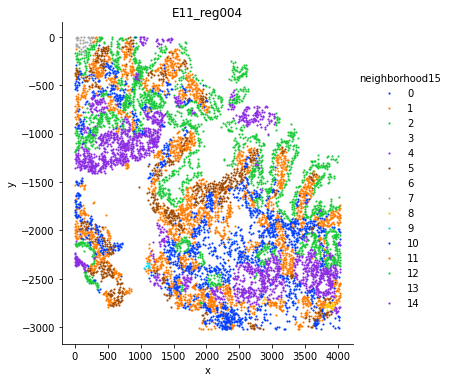

E11_reg005


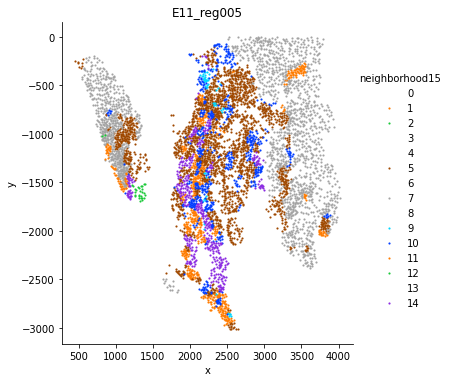

E11_reg006


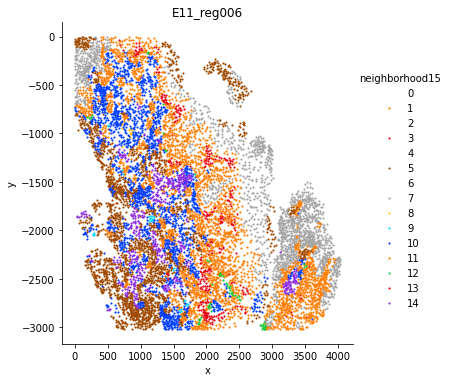

E17_reg001


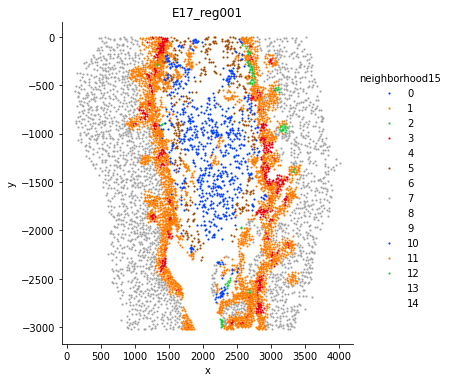

E17_reg002


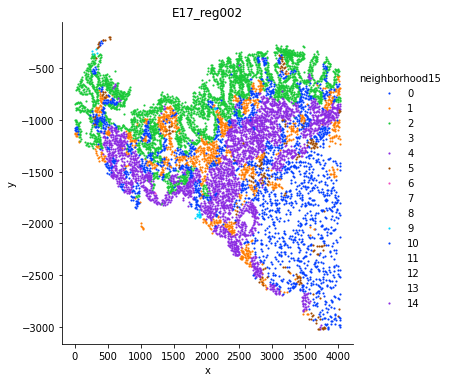

E17_reg003


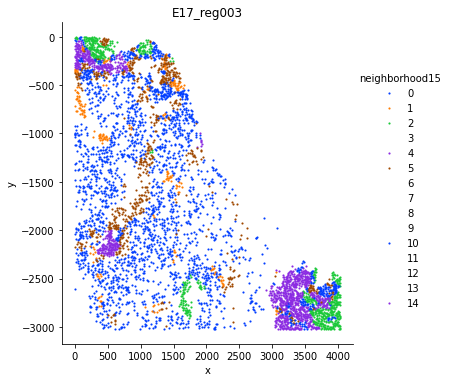

E17_reg004


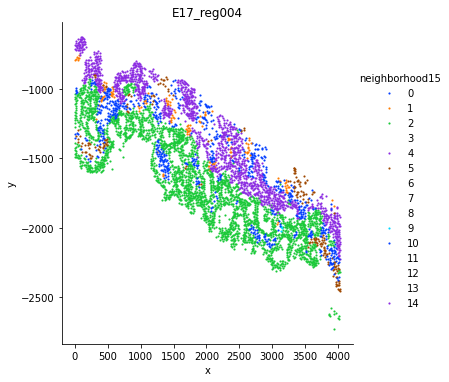

E17_reg005


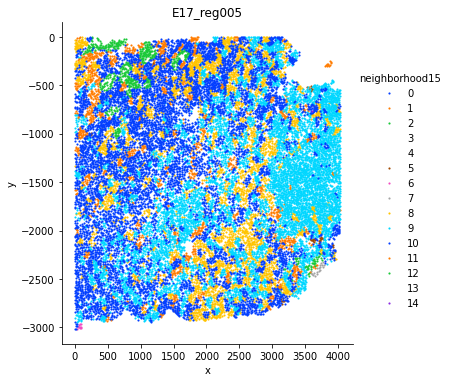

E17_reg006


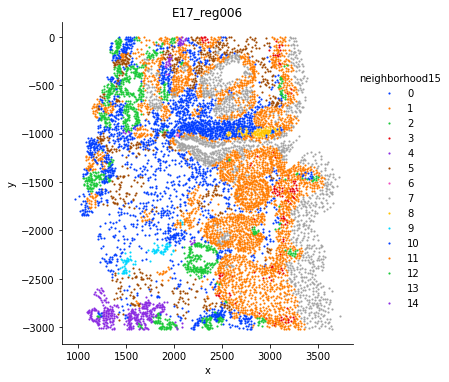

E19_reg001


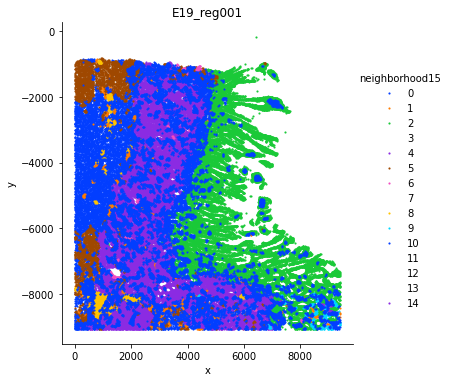

E19_reg002


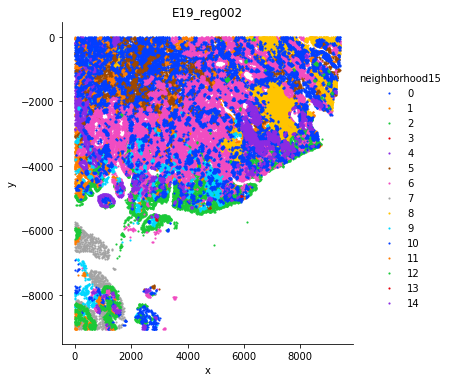

E19_reg003


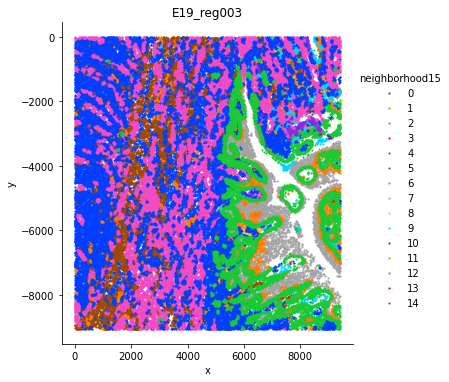

E19_reg004


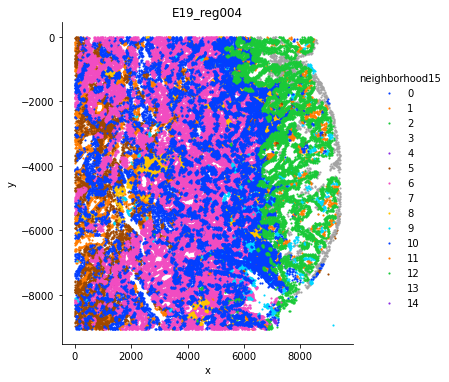

E12_reg001


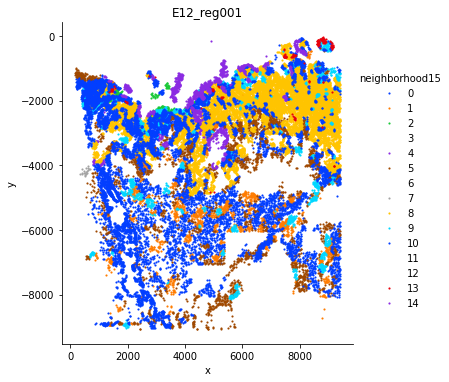

E12_reg002


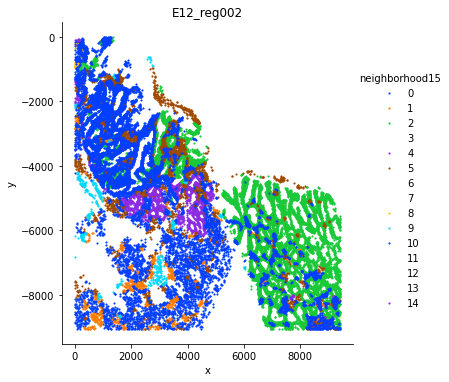

E12_reg003


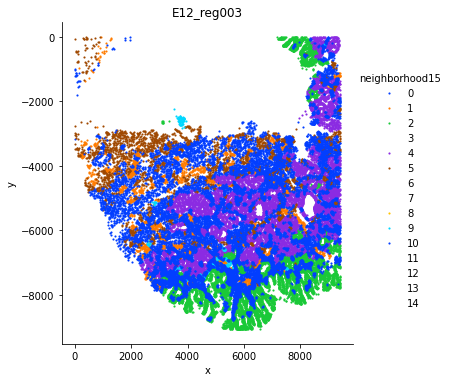

E12_reg004


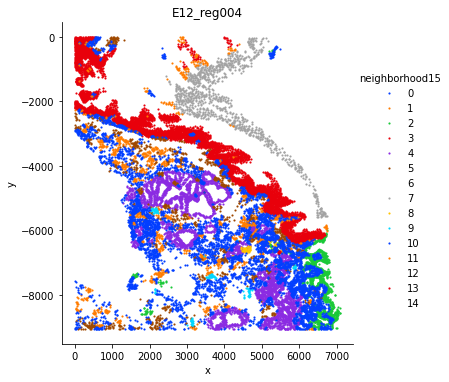

E12_reg005


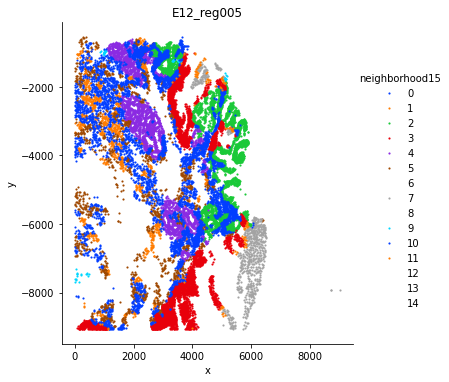

In [92]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [93]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

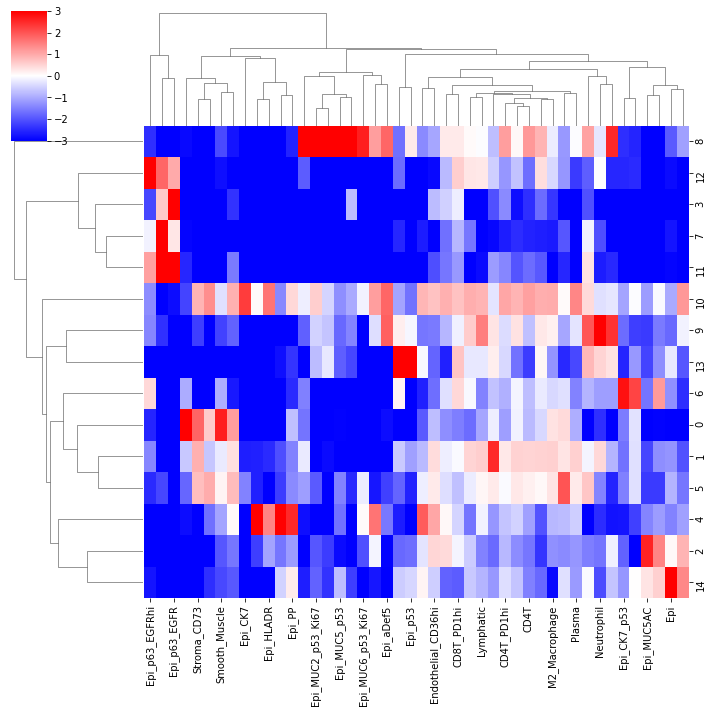

In [94]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

### Interaction

In [ ]:
w = windows[k]

english_annot = cells.groupby(cluster_col).apply(lambda x:x[cluster_col].unique()[0]).to_dict()

english_sum_cols = [english_annot[i] for i in sum_cols]
w = w.rename(columns = english_annot)
#english_sum_cols.remove('dirt')
w.head()

In [ ]:
for exp in exps[:]:
    region = w[w[reg]==exp]
    region_noNAs = region[english_sum_cols].corr().dropna(how='all', axis=1)
    region_noNAs = region_noNAs.dropna(how='all', axis=0)
    s = sns.clustermap(region_noNAs, cmap="bwr", vmax=.5)
    #s.savefig(save_path+"correlation_"+exp+"_"+str(k)+".pdf")
    plt.show()

# Evaluate Calculations by Graphical Interaction

### Fill In:
    -k:  window_size (needs to be in ks (saved above))
    -n_neighborhoods:  number of neighborhoods to find

In [ ]:
#Fill in based on above
k = 10
n_neighborhoods = 10
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [ ]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

In [ ]:
#modify figure size aesthetics for each neighborhood
figs = catplot(cells,X = X,Y=Y,exp = reg,hue = 'neighborhood'+str(k),invert_y=True,size = 5,)

In [ ]:
#Save Plots for Publication
for n,f in enumerate(figs):
    f.savefig(save_path+'neighborhood_'+str(k)+'_id{}.png'.format(n))

In [ ]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr')
#s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

In [ ]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc.iloc[[0,4,],:], vmin =-3,vmax = 3,cmap = 'bwr')
#s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

### Interaction

In [ ]:
w = windows[k]

english_annot = cells.groupby(cluster_col).apply(lambda x:x[cluster_col].unique()[0]).to_dict()

english_sum_cols = [english_annot[i] for i in sum_cols]
w = w.rename(columns = english_annot)
#english_sum_cols.remove('dirt')
w.head()

In [ ]:
for exp in exps[:]:
    region = w[w[reg]==exp]
    region_noNAs = region[english_sum_cols].corr().dropna(how='all', axis=1)
    region_noNAs = region_noNAs.dropna(how='all', axis=0)
    s = sns.clustermap(region_noNAs, cmap="bwr", vmax=.5)
    #s.savefig(save_path+"correlation_"+exp+"_"+str(k)+".pdf")
    plt.show()

# Use CODEX2 for analysis

In [ ]:
#plotting option2
ax = pd.crosstab(df['sample'], df['CODEX2']).plot(kind='barh', stacked=True,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_hstack.png', bbox_inches='tight')

In [ ]:
st = pd.crosstab(df['sample'], df['CODEX2'])

tmp=st.T.apply(
    lambda x: 100 * x / x.sum()
)

ax = tmp.T.plot(kind='barh', stacked=True,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_perc_hstack.png', bbox_inches='tight')

In [ ]:
tmp.head()

In [ ]:
from matplotlib import cm
celltype_df = pd.DataFrame(tmp.T)
platte = cm.get_cmap('tab20', len(celltype_df.columns))
print(platte.N)

In [ ]:
fig = plt.figure(figsize=(20,6))
vals, names, xs = [],[],[]
for i, col in enumerate(celltype_df.columns):
    vals.append(celltype_df[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, celltype_df[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val, c in zip(xs, vals, platte.colors):
    plt.scatter(x, val, alpha=0.4, color = c)
plt.xticks(rotation = 90)
plt.show()

In [ ]:
test = celltype_df
test.columns = test.columns.astype(str)
test['sample']=test.index.astype(str, copy = False)
test.head()

In [ ]:
import matplotlib.patches as mpatches
e8 = mpatches.Patch(color=donor_colors[0], label='E08')
e11 = mpatches.Patch(color=donor_colors[1], label='E11')
e12 = mpatches.Patch(color=donor_colors[2], label='E12')
e17 = mpatches.Patch(color=donor_colors[3],label='E17')
e18 = mpatches.Patch(color=donor_colors[4], label='E18')
e19 = mpatches.Patch(color=donor_colors[5], label = 'E19')

In [ ]:
#donor_colors = {'E08':'red', 'E11':'green', 'E12':'blue', 'E17':'yellow', 'E18':'purple', 'E19':'black'}
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
#donor_colors = cm.get_cmap('Dark2', 6).colors
fig = plt.figure(figsize=(24,18))
vals, names, xs = [],[],[]
for i, col in enumerate(celltype_df.columns[0:-1]):
    vals.append(celltype_df[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, celltype_df[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val, c in zip(xs, vals, platte.colors):
    plt.scatter(x, val, alpha=0.6, color = donor_colors)
plt.xticks(rotation = 90)
plt.legend(handles=[e8,e11, e12, e17, e18, e19])
plt.savefig('codex2_celltype_donor_perc.png')

In [ ]:
st = pd.crosstab(df['Path_report'], df['CODEX2'])

tmp=st.T.apply(
    lambda x: 100 * x / x.sum()
)
pathR_df = pd.DataFrame(tmp.T)
platte = cm.get_cmap('tab20', len(pathR_df.columns))
print(platte.N)

In [ ]:
pathR_df.head()

In [ ]:
pathR_df.index

In [ ]:
pathColors = ['red', 'green','blue', 'yellow', 'purple', 'rosybrown','olive', 'magenta','darkgreen']
p1 = mpatches.Patch(color=pathColors[0], label='Metaplasia')
p2 = mpatches.Patch(color=pathColors[1], label='Metaplasia + Dysplasia + Tumor')
p3= mpatches.Patch(color=pathColors[2], label='Metaplasia + Tumor')
p4 = mpatches.Patch(color=pathColors[3],label='Metaplasia; Dysplasia?')
p5 = mpatches.Patch(color=pathColors[4], label='Normal esophagus')
p6 = mpatches.Patch(color=pathColors[5], label = 'Normal esophagus; Tumor?')
p7 = mpatches.Patch(color=pathColors[0], label='Tumor')
p8 = mpatches.Patch(color=pathColors[1], label='Tumor + Dysplasia')
p9= mpatches.Patch(color=pathColors[2], label='Tumor + Metaplasia')

In [ ]:
fig = plt.figure(figsize=(24,15))
vals, names, xs = [],[],[]
for i, col in enumerate(pathR_df.columns):
    vals.append(pathR_df[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, pathR_df[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, color=pathColors)
plt.xticks(rotation = 90)
plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7, p8,p9])
plt.savefig('codex2_celltype_pathRep_perc.png')

In [ ]:
ax = tmp.T.plot(kind='barh', stacked=True,figsize = (10,10))
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
fig = ax.get_figure()
plt.savefig('codex2_composition_pathR_perc_hstack.png', bbox_inches='tight')

In [ ]:
convTab2 = pd.read_csv("../data/StCa_ESO-ATLAS-CODEX-integrationCelltype_JH_ISB_v2.csv")
convTab2.head()

In [ ]:
tab3 = pd.DataFrame(convTab2[["CODEX","Subtype"]])
tab3 = tab3.iloc[1:,:]
tab3.index = tab3["CODEX"]
tab3 = tab3.iloc[:,1:]
print(tab3.head())
tab3 = tab3.to_dict()
tab3 = tab3['Subtype']
print(tab3)

In [ ]:
df['subtype'] = (
    df['final_cell_types']
    .map(tab3).astype("category")
)

In [ ]:
df.subtype.value_counts()

In [ ]:
st_sub = pd.crosstab(df['CODEX2'], df['subtype'])
sub_perc = st_sub.apply(lambda x: x * 100/x.sum())
sub_perc.head()

In [ ]:
df_epi = df[df.subtype == 'Epithelial']
df_imm = df[df.subtype == 'Immune']
df_str = df[df.subtype == 'Stromal']

In [ ]:
st_epi = pd.crosstab(df_epi['Path_report'], df_epi['CODEX2'])
st_imm = pd.crosstab(df_imm['Path_report'], df_imm['CODEX2'])
st_str = pd.crosstab(df_str['Path_report'], df_str['CODEX2'])

In [ ]:
tmp=st_epi.T.apply(
    lambda x: 100 * x / x.sum()
)
pathR_df_epi = pd.DataFrame(tmp.T)

In [ ]:
plt.rcParams.update({'font.size': 22})

donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(pathR_df_epi.columns):
    vals.append(pathR_df_epi[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, pathR_df_epi[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=pathColors)
plt.xticks(rotation = 90)
plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7, p8,p9])
plt.rc('xtick',labelsize=8)
#plt.show()
plt.savefig('codex2_epi_celltype_pathRep_perc.png')

### stroma

In [ ]:
tmp=st_str.T.apply(
    lambda x: 100 * x / x.sum()
)
pathR_df_str = pd.DataFrame(tmp.T)

In [ ]:
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(pathR_df_str.columns):
    vals.append(pathR_df_str[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, pathR_df_str[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=pathColors)
plt.xticks(rotation = 90)
plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7, p8,p9])
#plt.rc('xtick',labelsize=8)
#plt.show()
plt.savefig('codex2_str_celltype_pathRep_perc.png')

### immune

In [ ]:
tmp=st_imm.T.apply(
    lambda x: 100 * x / x.sum()
)
pathR_df_imm = pd.DataFrame(tmp.T)

In [ ]:
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(pathR_df_imm.columns):
    vals.append(pathR_df_imm[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, pathR_df_imm[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=pathColors)
plt.xticks(rotation = 90)
plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7, p8,p9])
plt.rc('xtick',labelsize=20)
#plt.show()
plt.savefig('codex2_immu_celltype_pathRep_perc.png')

## donor type

In [ ]:
st_epi = pd.crosstab(df_epi['sample'], df_epi['CODEX2'])
st_imm = pd.crosstab(df_imm['sample'], df_imm['CODEX2'])
st_str = pd.crosstab(df_str['sample'], df_str['CODEX2'])

In [ ]:
tmp=st_epi.T.apply(
    lambda x: 100 * x / x.sum()
)
donor_df_epi = pd.DataFrame(tmp.T)

In [ ]:
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(donor_df_epi.columns):
    vals.append(donor_df_epi[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, donor_df_epi[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=donor_colors)
plt.xticks(rotation = 90)
plt.legend(handles=[e8,e11, e12, e17, e18, e19])
plt.rc('xtick',labelsize=10)
#plt.show()
plt.savefig('codex2_epi_celltype_donor_perc.png')

### stroma

In [ ]:
tmp=st_str.T.apply(
    lambda x: 100 * x / x.sum()
)
donor_df_str = pd.DataFrame(tmp.T)

In [ ]:
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(donor_df_str.columns):
    vals.append(donor_df_str[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, donor_df_str[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=donor_colors)
plt.xticks(rotation = 90)
plt.legend(handles=[e8,e11, e12, e17, e18, e19])
plt.rc('xtick',labelsize=20)
#plt.show()
plt.savefig('codex2_str_celltype_donor_perc.png')

### immune

In [ ]:
tmp=st_imm.T.apply(
    lambda x: 100 * x / x.sum()
)
donor_df_imm = pd.DataFrame(tmp.T)

In [ ]:
donor_colors = ['red', 'green','blue', 'yellow', 'purple', 'black']
fig = plt.figure(figsize=(30,20))
vals, names, xs = [],[],[]
for i, col in enumerate(donor_df_imm.columns):
    vals.append(donor_df_imm[col].values)
    names.append(col)
    xs.append(np.random.normal(i + 1, 0.04, donor_df_imm[col].values.shape[0]))  # adds jitter to the data points - can be adjusted
plt.boxplot(vals, labels=names, showfliers=False) 
for x, val in zip(xs, vals):
    plt.scatter(x, val, alpha=0.6, s=100, color=donor_colors)
plt.xticks(rotation = 90)
plt.legend(handles=[e8,e11, e12, e17, e18, e19])
plt.rc('xtick',labelsize=20)
#plt.show()
plt.savefig('codex2_immu_celltype_donor_perc.png')